In [1]:
import wandb

In [2]:
wandb.login()

True

In [3]:
wandb.init(project="lorenz_rnn", group="lorenz_rnn",save_code=True,notes="Lorenz RNN run and evaluation")

In [4]:
from torchdiffeq import odeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn import functional as F
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import clear_output

In [5]:
def visualize_3d(obs=None, noiseless_traj=None,times=None, trajs=None, save=None, title=''):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    if title is not None:
      ax.set_title('Trajectory\n'+title)

    if noiseless_traj is not None:
      z = np.array([o.detach().numpy() for o in noiseless_traj])
      z = np.reshape(z, [-1,3])
      for i in range(len(z)):
        ax.plot(z[i:i+10, 0], z[i:i+10, 1], z[i:i+10, 2], color=plt.cm.jet(i/len(z)/1.6))

    if obs is not None:
      z = np.array([o.detach().numpy() for o in obs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='.', color='k', alpha=0.5, linewidths=0, s=45)

    if trajs is not None:
      z = np.array([o.detach().numpy() for o in trajs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='^', color='r', alpha=0.5, linewidths=0, s=45)

    fig.canvas.draw()
    fig.canvas.flush_events()
    if save is not None:
        plt.savefig(save+'.png', format='png', dpi=400, bbox_inches ='tight', pad_inches = 0.1)
    plt.show()

In [6]:
class Lorenz(nn.Module):
    """
    chaotic lorenz system
    """
    def __init__(self):
        super(Lorenz, self).__init__()
        self.lin = nn.Linear(5, 3, bias=False)
        W = torch.tensor([[-10., 10., 0., 0., 0.],
                          [28., -1., 0., -1., 0.],
                          [0., 0., -8. / 3., 0., 1.]])
        self.lin.weight = nn.Parameter(W)

    def forward(self, t, x):
        y = y = torch.ones([1, 5])
        y[0][0] = x[0][0]
        y[0][1] = x[0][1]
        y[0][2] = x[0][2]
        y[0][3] = x[0][0] * x[0][2]
        y[0][4] = x[0][0] * x[0][1]
        return self.lin(y)

true_y0 = torch.tensor([[-8., 7., 27.]])  # initial condition
t = torch.linspace(0., 25., 5000)  # t is from 0 to 25 for 1000 data points

# generating training data
with torch.no_grad():
    true_lorenz = odeint(Lorenz(), true_y0, t)

visualize_3d(obs=true_lorenz)

In [7]:
class LorenzRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LorenzRNN, self).__init__()

        self.hidden_size = hidden_size

        # Define the RNN layer
        self.rnn = nn.RNN(input_size, hidden_size,batch_first=True)
        self.activation = nn.ReLU()
        # Define the linear layer to map from hidden space to output space
        self.linear = nn.Linear(hidden_size, output_size)

    def forward(self, input_seq):
        # Reshape the input to match the batch_first format (batch_size, seq_len, input_size)
        

        # Initialize hidden state with zeros
        hidden_state = torch.zeros(1, input_seq.size(0), self.hidden_size)

        # Get RNN outputs and hidden state
        rnn_out, hidden_state = self.rnn(input_seq, hidden_state)
        act_out = self.activation(rnn_out)
        # Apply linear layer to the output of the last time step
        output = self.linear(act_out)

        # Remove the additional batch dimension from the output
        #output = output.squeeze(0)

        return output.squeeze(0)

# Define input size, hidden size, and output size
input_size = 3
hidden_size = 512
output_size = 3

# Create the model
model = LorenzRNN(input_size, hidden_size, output_size)

In [8]:
true_lorenz.shape

torch.Size([5000, 1, 3])

In [9]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    batch_y0 = true_y[indices]  # (batch_size, D)
    batch_t = t[:batch_size]  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_t, batch_y

In [10]:
x,t,y = get_batch(true_lorenz, batch_size=5)

In [11]:
x.size(0)

5

In [12]:
x.shape,t.shape,y.shape

(torch.Size([5, 1, 3]), torch.Size([5]), torch.Size([5, 5, 1, 3]))

In [13]:

# Loss function
criterion = nn.MSELoss()

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Convert true_lorenz to a tensor
true_lorenz_tensor = true_lorenz

# Training loop
num_epochs = 3000
for epoch in range(num_epochs):
    optimizer.zero_grad()
    x,t,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
    predicted_lorenz = model(true_lorenz)

    # Compute the loss
    loss = criterion(predicted_lorenz, true_lorenz)

    # Backpropagation
    loss.backward()
    optimizer.step()

    if epoch % 50 == 0:
        
        predictions = []
        with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(20000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
        predictions = torch.stack(predictions)
        loss = F.mse_loss(predictions, true_lorenz)
        visualize_3d(obs=true_lorenz, trajs=predictions)
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
        clear_output(wait=True)

In [14]:
t.shape

torch.Size([5])

In [15]:
def visualize_3d(obs=None, noiseless_traj=None,times=None, trajs=None, save=None, title=''):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    if title is not None:
      ax.set_title('Trajectory\n'+title)

    if noiseless_traj is not None:
      z = np.array([o.detach().numpy() for o in noiseless_traj])
      z = np.reshape(z, [-1,3])
      for i in range(len(z)):
        ax.plot(z[i:i+10, 0], z[i:i+10, 1], z[i:i+10, 2], color=plt.cm.jet(i/len(z)/1.6))

    if obs is not None:
      z = np.array([o.detach().numpy() for o in obs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='.', color='k', alpha=0.5, linewidths=0, s=45)

    if trajs is not None:
      z = np.array([o.detach().numpy() for o in trajs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='^', color='r', alpha=0.5, linewidths=0, s=45)

    fig.canvas.draw()
    fig.canvas.flush_events()
    if save is not None:
        plt.savefig(save+'.png', format='png', dpi=400, bbox_inches ='tight', pad_inches = 0.1)
    plt.show()

In [16]:
class Lorenz(nn.Module):
    """
    chaotic lorenz system
    """
    def __init__(self):
        super(Lorenz, self).__init__()
        self.lin = nn.Linear(5, 3, bias=False)
        W = torch.tensor([[-10., 10., 0., 0., 0.],
                          [28., -1., 0., -1., 0.],
                          [0., 0., -8. / 3., 0., 1.]])
        self.lin.weight = nn.Parameter(W)

    def forward(self, t, x):
        y = y = torch.ones([1, 5])
        y[0][0] = x[0][0]
        y[0][1] = x[0][1]
        y[0][2] = x[0][2]
        y[0][3] = x[0][0] * x[0][2]
        y[0][4] = x[0][0] * x[0][1]
        return self.lin(y)

true_y0 = torch.tensor([[-8., 7., 27.]])  # initial condition
t = torch.linspace(0., 25., 5000)  # t is from 0 to 25 for 1000 data points

# generating training data
with torch.no_grad():
    true_lorenz = odeint(Lorenz(), true_y0, t)

visualize_3d(obs=true_lorenz)

In [17]:
t.shape

torch.Size([5000])

In [18]:
import wandb

In [19]:
wandb.login()

True

In [20]:
wandb.init(project="lorenz_rnn", group="lorenz_rnn",save_code=True,notes="Lorenz RNN run and evaluation")

In [21]:
from torchdiffeq import odeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn import functional as F
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import clear_output

In [22]:
def visualize_3d(obs=None, noiseless_traj=None,times=None, trajs=None, save=None, title=''):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    if title is not None:
      ax.set_title('Trajectory\n'+title)

    if noiseless_traj is not None:
      z = np.array([o.detach().numpy() for o in noiseless_traj])
      z = np.reshape(z, [-1,3])
      for i in range(len(z)):
        ax.plot(z[i:i+10, 0], z[i:i+10, 1], z[i:i+10, 2], color=plt.cm.jet(i/len(z)/1.6))

    if obs is not None:
      z = np.array([o.detach().numpy() for o in obs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='.', color='k', alpha=0.5, linewidths=0, s=45)

    if trajs is not None:
      z = np.array([o.detach().numpy() for o in trajs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='^', color='r', alpha=0.5, linewidths=0, s=45)

    fig.canvas.draw()
    fig.canvas.flush_events()
    if save is not None:
        plt.savefig(save+'.png', format='png', dpi=400, bbox_inches ='tight', pad_inches = 0.1)
    plt.show()

In [23]:
class Lorenz(nn.Module):
    """
    chaotic lorenz system
    """
    def __init__(self):
        super(Lorenz, self).__init__()
        self.lin = nn.Linear(5, 3, bias=False)
        W = torch.tensor([[-10., 10., 0., 0., 0.],
                          [28., -1., 0., -1., 0.],
                          [0., 0., -8. / 3., 0., 1.]])
        self.lin.weight = nn.Parameter(W)

    def forward(self, t, x):
        y = y = torch.ones([1, 5])
        y[0][0] = x[0][0]
        y[0][1] = x[0][1]
        y[0][2] = x[0][2]
        y[0][3] = x[0][0] * x[0][2]
        y[0][4] = x[0][0] * x[0][1]
        return self.lin(y)

true_y0 = torch.tensor([[-8., 7., 27.]])  # initial condition
t = torch.linspace(0., 25., 5000)  # t is from 0 to 25 for 1000 data points

# generating training data
with torch.no_grad():
    true_lorenz = odeint(Lorenz(), true_y0, t)

visualize_3d(obs=true_lorenz)

In [24]:
t.shape

torch.Size([5000])

In [25]:
class LorenzRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LorenzRNN, self).__init__()

        self.hidden_size = hidden_size

        # Define the RNN layer
        self.rnn = nn.RNN(input_size, hidden_size,batch_first=True)
        self.activation = nn.ReLU()
        # Define the linear layer to map from hidden space to output space
        self.linear = nn.Linear(hidden_size, output_size)

    def forward(self, input_seq):
        # Reshape the input to match the batch_first format (batch_size, seq_len, input_size)
        

        # Initialize hidden state with zeros
        hidden_state = torch.zeros(1, input_seq.size(0), self.hidden_size)

        # Get RNN outputs and hidden state
        rnn_out, hidden_state = self.rnn(input_seq, hidden_state)
        act_out = self.activation(rnn_out)
        # Apply linear layer to the output of the last time step
        output = self.linear(act_out)

        # Remove the additional batch dimension from the output
        #output = output.squeeze(0)

        return output.squeeze(0)

# Define input size, hidden size, and output size
input_size = 3
hidden_size = 512
output_size = 3

# Create the model
model = LorenzRNN(input_size, hidden_size, output_size)

In [26]:
true_lorenz.shape

torch.Size([5000, 1, 3])

In [27]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    batch_y0 = true_y[indices]  # (batch_size, D)
    batch_t = t[:batch_size]  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_t, batch_y

In [28]:

# Loss function
criterion = nn.MSELoss()

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Convert true_lorenz to a tensor
true_lorenz_tensor = true_lorenz

# Training loop
num_epochs = 3000
for epoch in range(num_epochs):
    optimizer.zero_grad()
    x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
    predicted_lorenz = model(true_lorenz)

    # Compute the loss
    loss = criterion(predicted_lorenz, true_lorenz)

    # Backpropagation
    loss.backward()
    optimizer.step()

    if epoch % 50 == 0:
        
        predictions = []
        with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(20000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
        predictions = torch.stack(predictions)
        loss = F.mse_loss(predictions, true_lorenz)
        visualize_3d(obs=true_lorenz, trajs=predictions)
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
        clear_output(wait=True)

In [29]:

# Loss function
criterion = nn.MSELoss()

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Convert true_lorenz to a tensor
true_lorenz_tensor = true_lorenz

# Training loop
num_epochs = 3000
for epoch in range(num_epochs):
    optimizer.zero_grad()
    x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
    predicted_lorenz = model(true_lorenz)

    # Compute the loss
    loss = criterion(predicted_lorenz, y)

    # Backpropagation
    loss.backward()
    optimizer.step()

    if epoch % 50 == 0:
        
        predictions = []
        with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
        predictions = torch.stack(predictions)
        loss = F.mse_loss(predictions, true_lorenz)
        visualize_3d(obs=true_lorenz, trajs=predictions)
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
        clear_output(wait=True)

In [30]:
x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
predicted_lorenz = model(true_lorenz)

In [31]:
predicted_lorenz.shape

torch.Size([5000, 1, 3])

In [32]:
x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
predicted_lorenz = model(x)

In [33]:
predicted_lorenz.shape

torch.Size([50, 1, 3])

In [34]:
import wandb

In [35]:
wandb.login()

True

In [36]:
wandb.init(project="lorenz_rnn", group="lorenz_rnn",save_code=True,notes="Lorenz RNN run and evaluation")

In [37]:
from torchdiffeq import odeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn import functional as F
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import clear_output

In [38]:
def visualize_3d(obs=None, noiseless_traj=None,times=None, trajs=None, save=None, title=''):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    if title is not None:
      ax.set_title('Trajectory\n'+title)

    if noiseless_traj is not None:
      z = np.array([o.detach().numpy() for o in noiseless_traj])
      z = np.reshape(z, [-1,3])
      for i in range(len(z)):
        ax.plot(z[i:i+10, 0], z[i:i+10, 1], z[i:i+10, 2], color=plt.cm.jet(i/len(z)/1.6))

    if obs is not None:
      z = np.array([o.detach().numpy() for o in obs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='.', color='k', alpha=0.5, linewidths=0, s=45)

    if trajs is not None:
      z = np.array([o.detach().numpy() for o in trajs])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='^', color='r', alpha=0.5, linewidths=0, s=45)

    fig.canvas.draw()
    fig.canvas.flush_events()
    if save is not None:
        plt.savefig(save+'.png', format='png', dpi=400, bbox_inches ='tight', pad_inches = 0.1)
    plt.show()

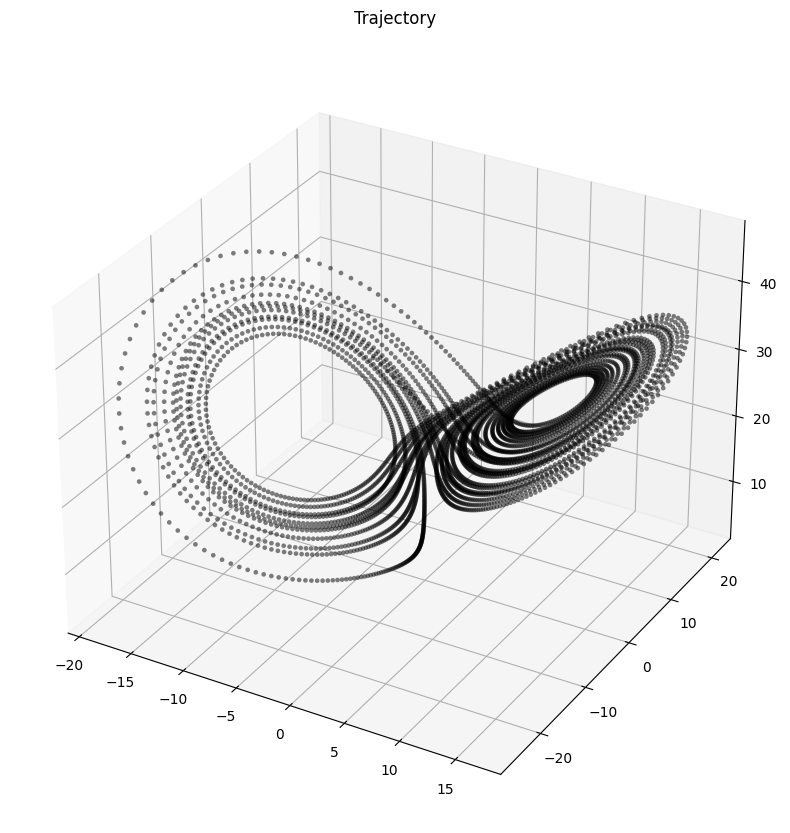

In [39]:
class Lorenz(nn.Module):
    """
    chaotic lorenz system
    """
    def __init__(self):
        super(Lorenz, self).__init__()
        self.lin = nn.Linear(5, 3, bias=False)
        W = torch.tensor([[-10., 10., 0., 0., 0.],
                          [28., -1., 0., -1., 0.],
                          [0., 0., -8. / 3., 0., 1.]])
        self.lin.weight = nn.Parameter(W)

    def forward(self, t, x):
        y = y = torch.ones([1, 5])
        y[0][0] = x[0][0]
        y[0][1] = x[0][1]
        y[0][2] = x[0][2]
        y[0][3] = x[0][0] * x[0][2]
        y[0][4] = x[0][0] * x[0][1]
        return self.lin(y)

true_y0 = torch.tensor([[-8., 7., 27.]])  # initial condition
t = torch.linspace(0., 25., 5000)  # t is from 0 to 25 for 1000 data points

# generating training data
with torch.no_grad():
    true_lorenz = odeint(Lorenz(), true_y0, t)

visualize_3d(obs=true_lorenz)

In [40]:
t.shape

torch.Size([5000])

In [41]:
class LorenzRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LorenzRNN, self).__init__()

        self.hidden_size = hidden_size

        # Define the RNN layer
        self.rnn = nn.RNN(input_size, hidden_size,batch_first=True)
        self.activation = nn.ReLU()
        # Define the linear layer to map from hidden space to output space
        self.linear = nn.Linear(hidden_size, output_size)

    def forward(self, input_seq):
        # Reshape the input to match the batch_first format (batch_size, seq_len, input_size)
        

        # Initialize hidden state with zeros
        hidden_state = torch.zeros(1, input_seq.size(0), self.hidden_size)

        # Get RNN outputs and hidden state
        rnn_out, hidden_state = self.rnn(input_seq, hidden_state)
        act_out = self.activation(rnn_out)
        # Apply linear layer to the output of the last time step
        output = self.linear(act_out)

        # Remove the additional batch dimension from the output
        #output = output.squeeze(0)

        return output.squeeze(0)

# Define input size, hidden size, and output size
input_size = 3
hidden_size = 512
output_size = 3

# Create the model
model = LorenzRNN(input_size, hidden_size, output_size)

In [42]:
true_lorenz.shape

torch.Size([5000, 1, 3])

In [43]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    batch_y0 = true_y[indices]  # (batch_size, D)
    batch_t = t[:batch_size]  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_t, batch_y

In [44]:
x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
predicted_lorenz = model(x)

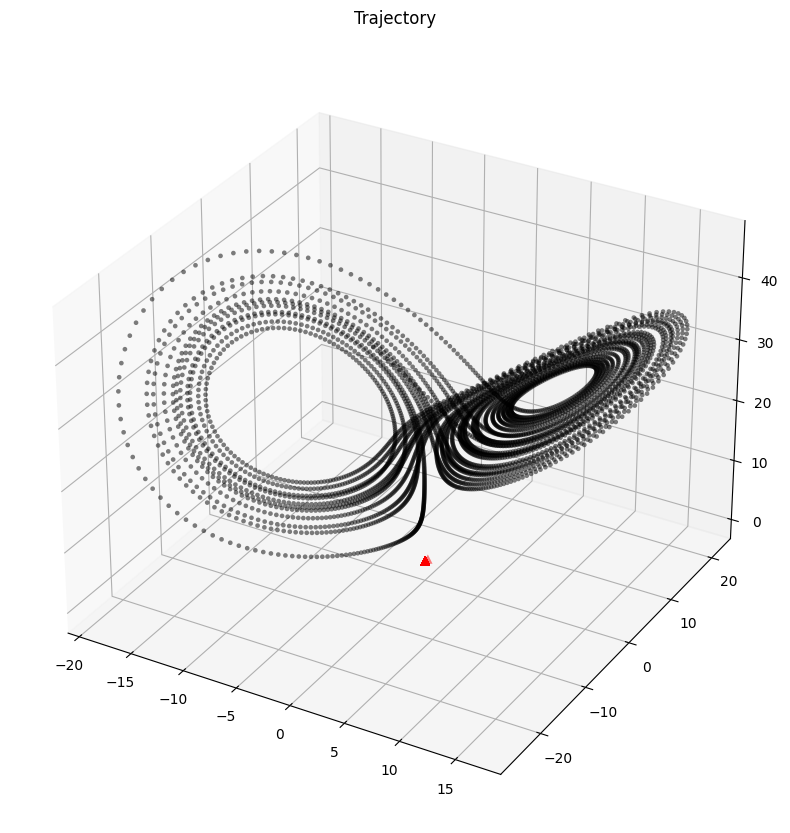

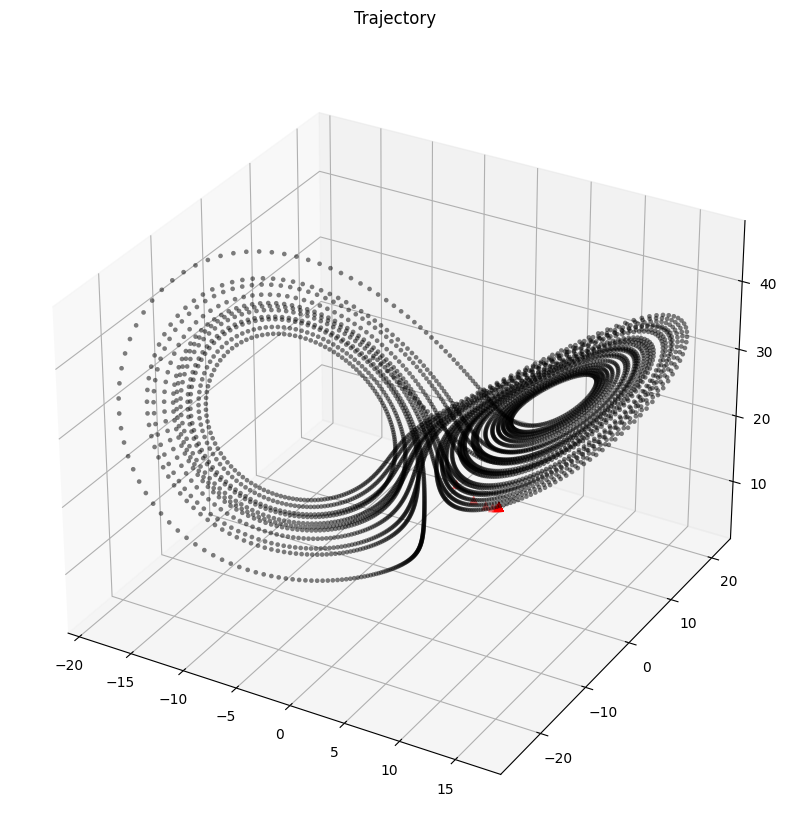

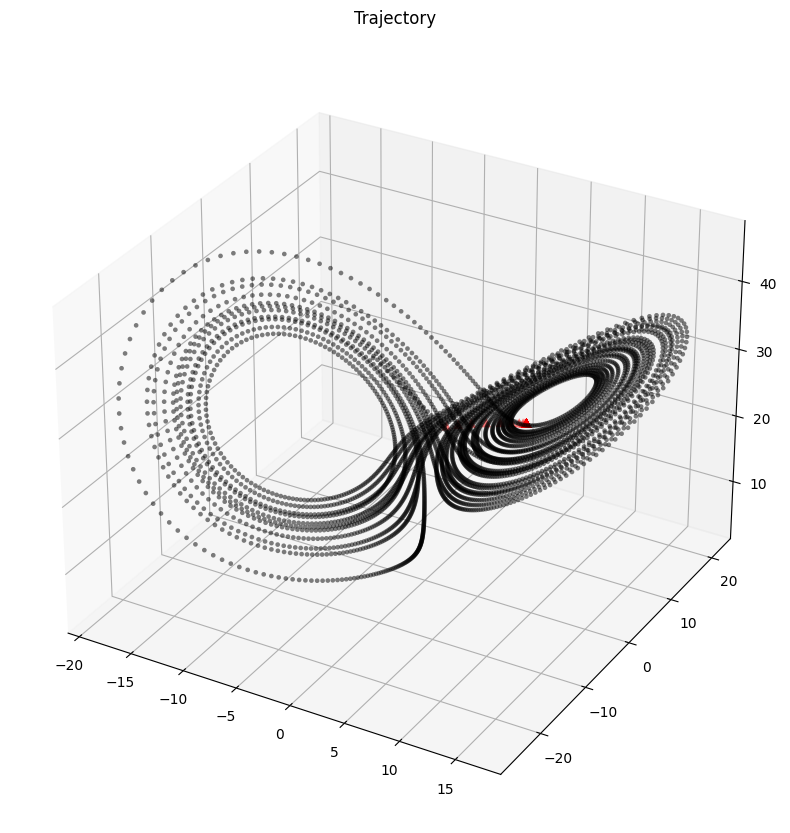

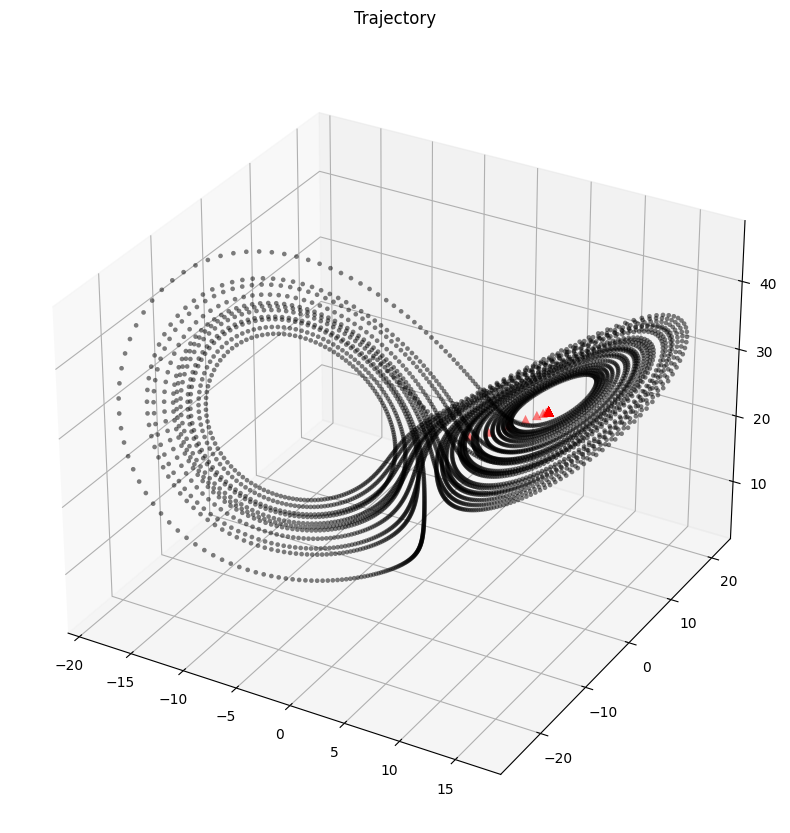

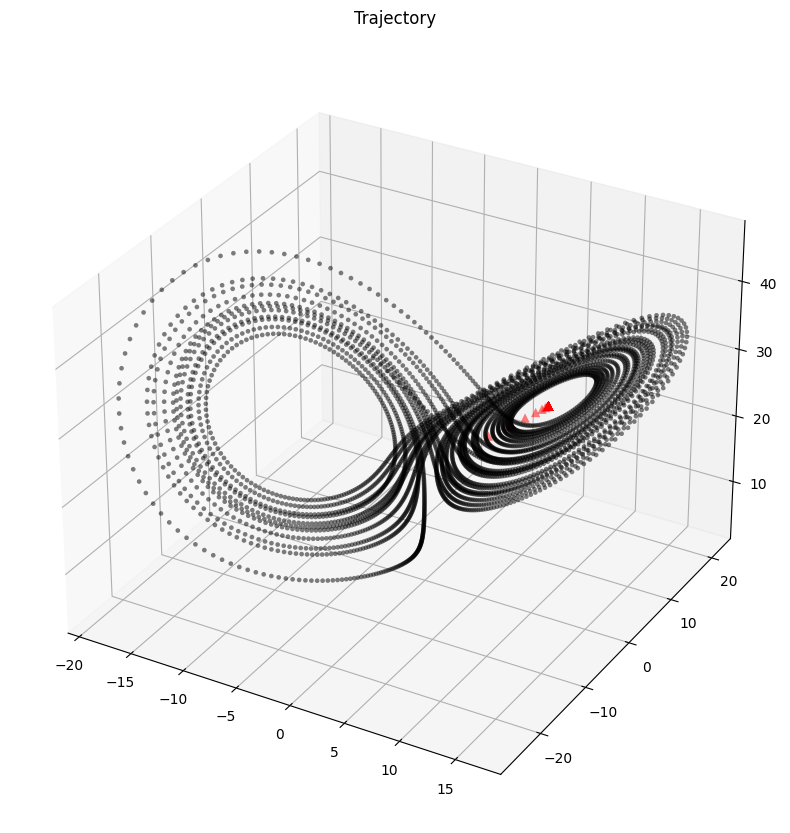

...

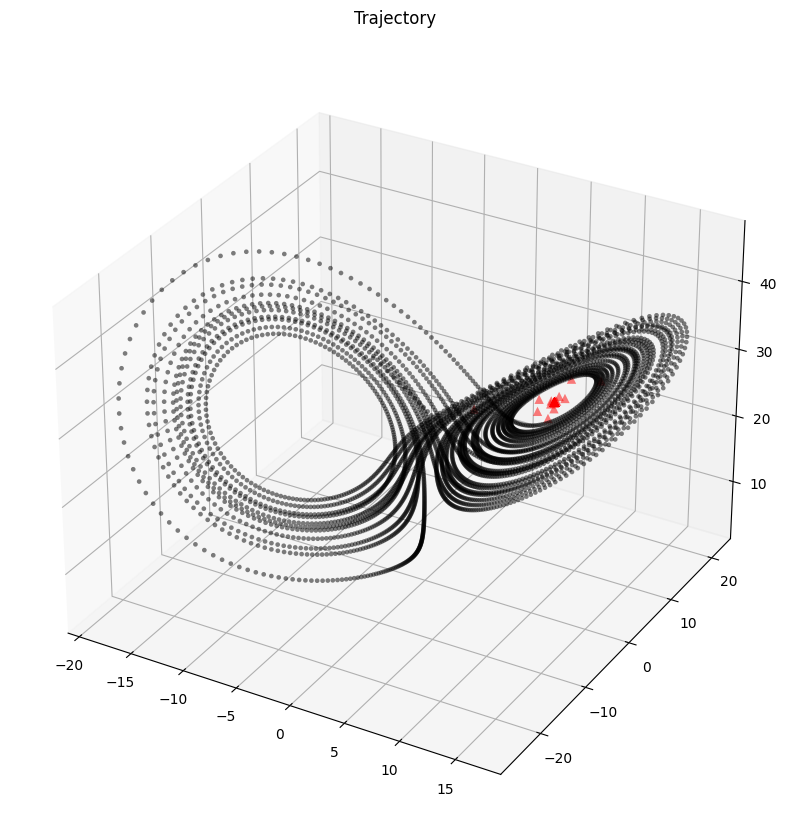

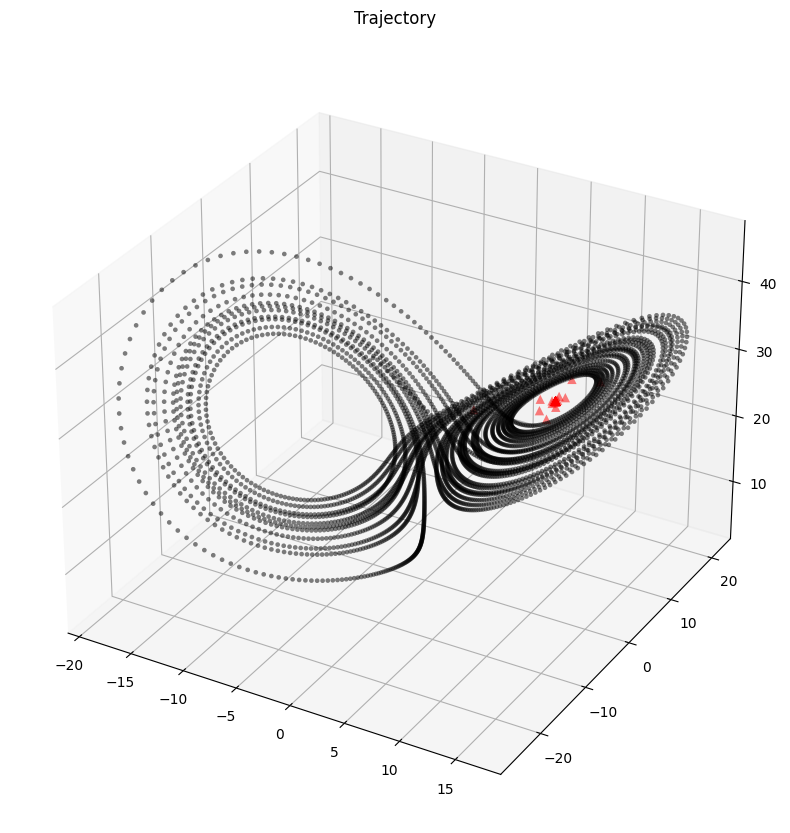

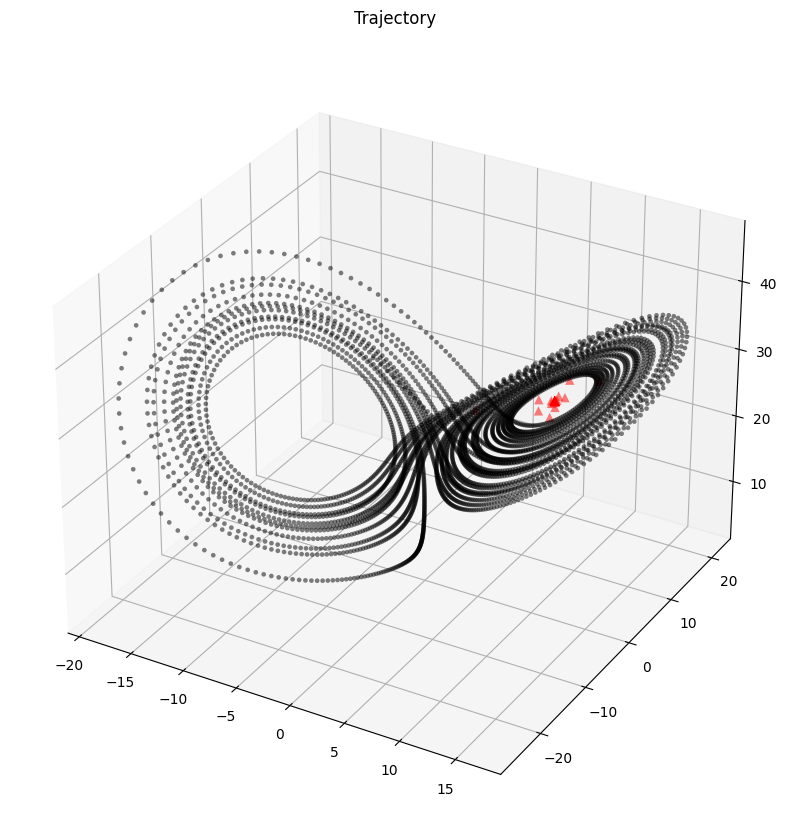

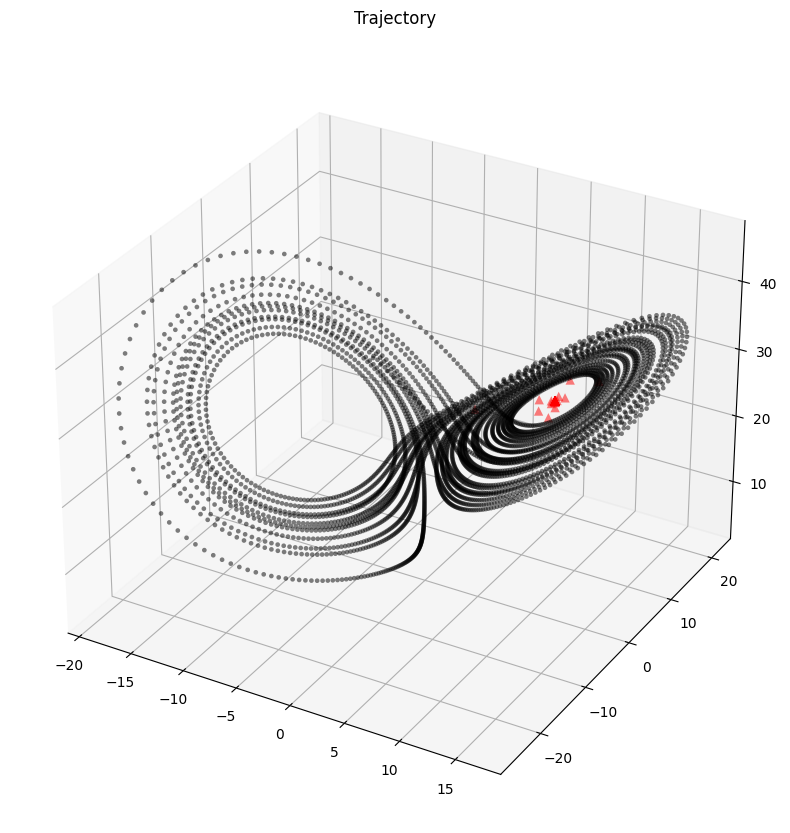

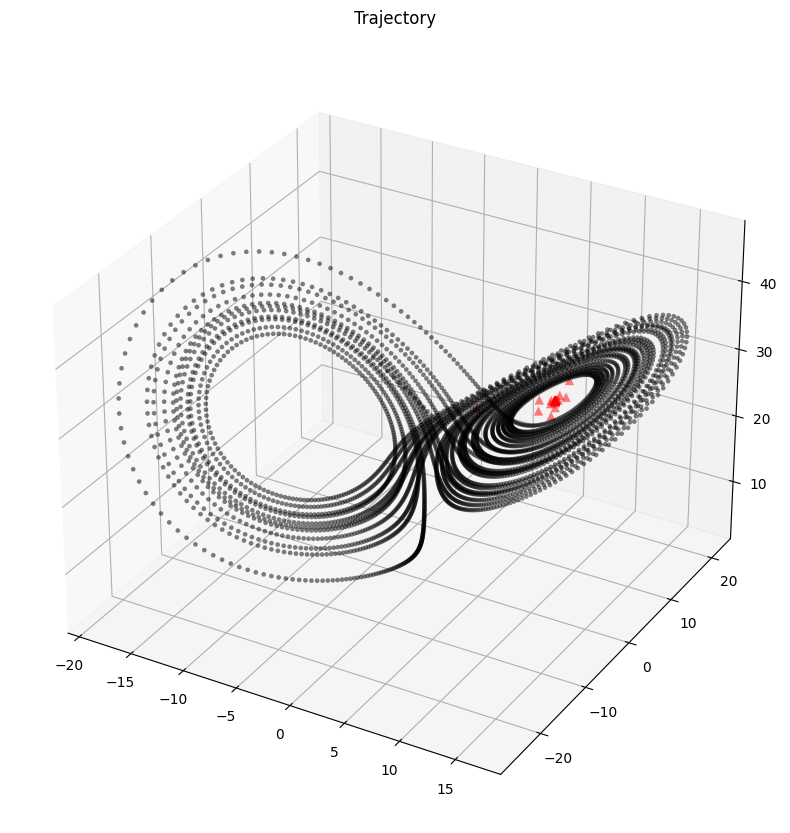

In [45]:

# Loss function
criterion = nn.MSELoss()

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Convert true_lorenz to a tensor
true_lorenz_tensor = true_lorenz

# Training loop
num_epochs = 3000
for epoch in range(num_epochs):
    optimizer.zero_grad()
    x,time,y = get_batch(true_lorenz_tensor, batch_size=50)
    # Forward pass
    predicted_lorenz = model(x)

    # Compute the loss
    loss = criterion(predicted_lorenz, y)

    # Backpropagation
    loss.backward()
    optimizer.step()

    if epoch % 50 == 0:
        
        predictions = []
        with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
        predictions = torch.stack(predictions)
        loss = F.mse_loss(predictions, true_lorenz)
        visualize_3d(obs=true_lorenz, trajs=predictions)
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
        clear_output(wait=True)

In [46]:
true_y0.shape

torch.Size([1, 3])

In [47]:
with torch.no_grad():
    predictions = model(true_lorenz)

In [48]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(20000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
            predictions = torch.stack(predictions)

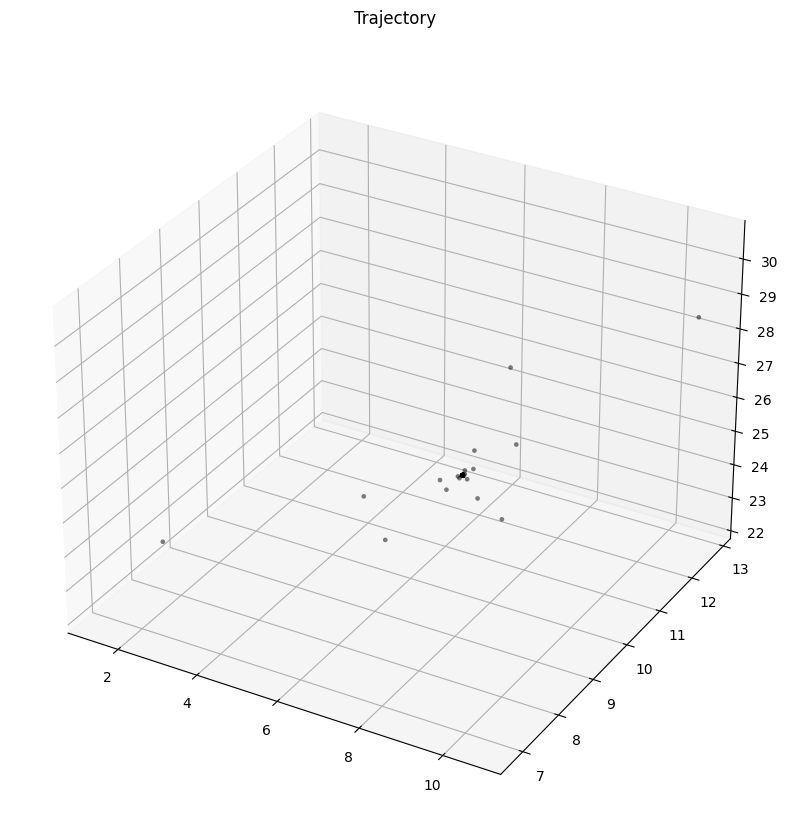

In [49]:
visualize_3d(obs = predictions)

In [50]:
true_lorenz_tensor[0]

tensor([[-8.,  7., 27.]])

In [51]:
predicted_lorenz.shape

torch.Size([50, 1, 3])

In [52]:
input_seq = true_y0

In [53]:
predictions.shape

torch.Size([20000, 1, 3])

In [54]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [55]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

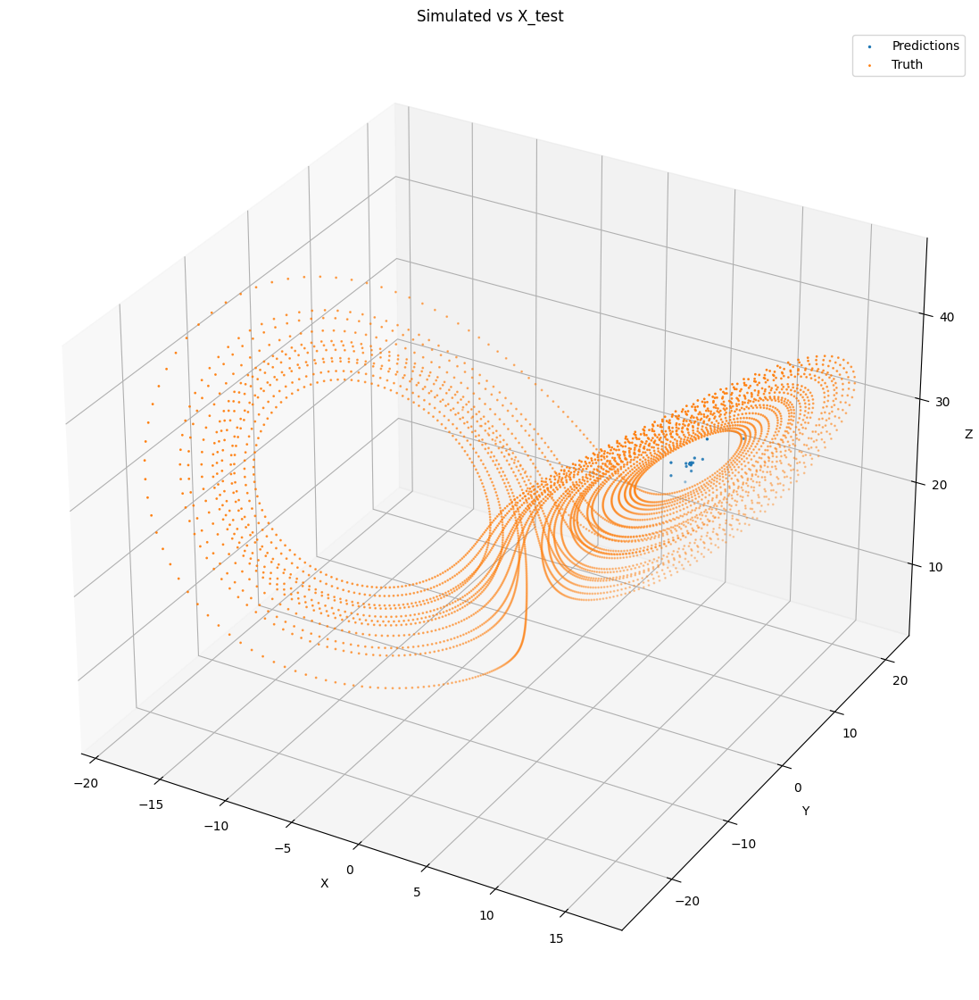

In [56]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

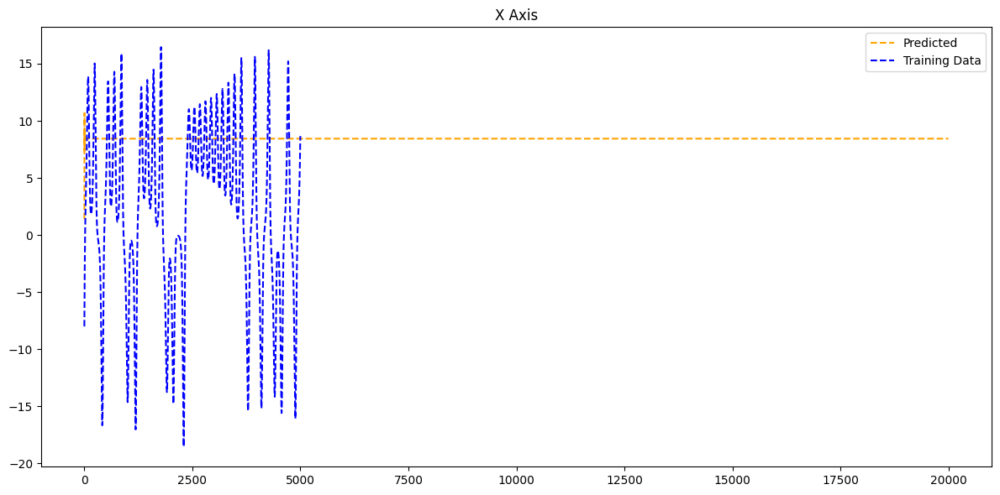

In [57]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

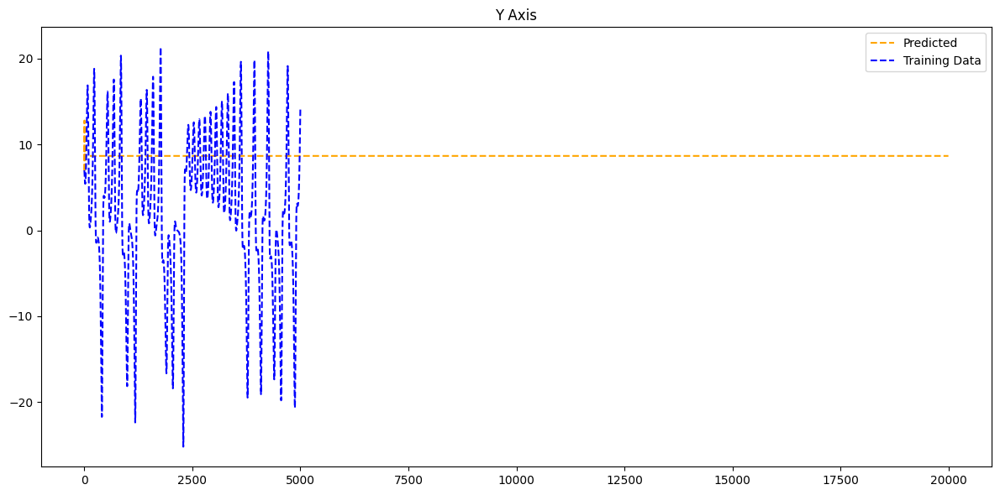

In [58]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(y_train, label='Training Data',color='blue',linestyle='--')
plt.title('Y Axis')
plt.legend()
plt.tight_layout()
plt.show()

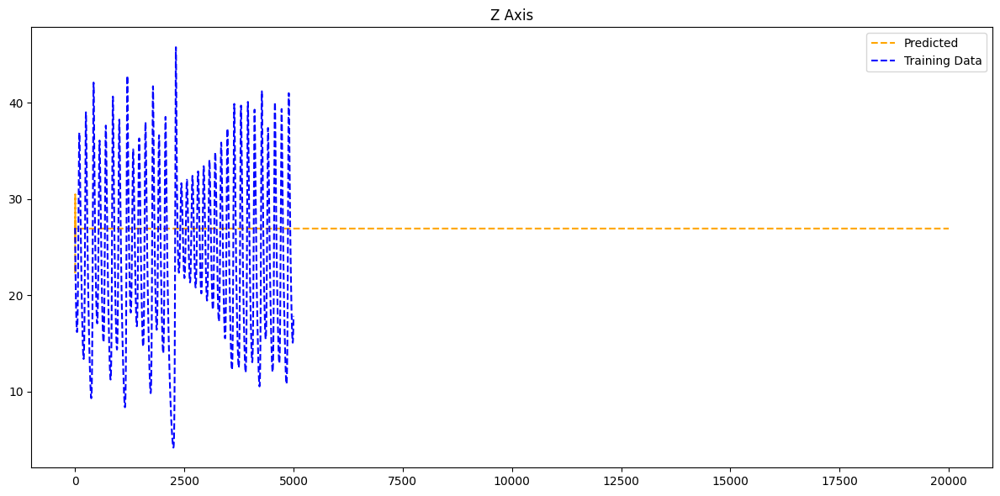

In [59]:
plt.figure(figsize=(12, 6))
plt.plot(z_pred, label='Predicted',linestyle='--',color='orange')
plt.plot(z_train, label='Training Data',color='blue',linestyle='--')
plt.title('Z Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [60]:
predictions = []
with torch.no_grad():
    for i in range(3):
        output = model(input_seq.unsqueeze(0))
        #output = output.squeeze(0)
        predictions.append(output)
        input_seq = output
predictions = torch.stack(predictions)

In [61]:
predictions.shape

torch.Size([3, 1, 3])

In [62]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [63]:
x_train = true_lorenz[:3, :, 0]
y_train = true_lorenz[:3, :, 1]
z_train = true_lorenz[:3, :, 2]

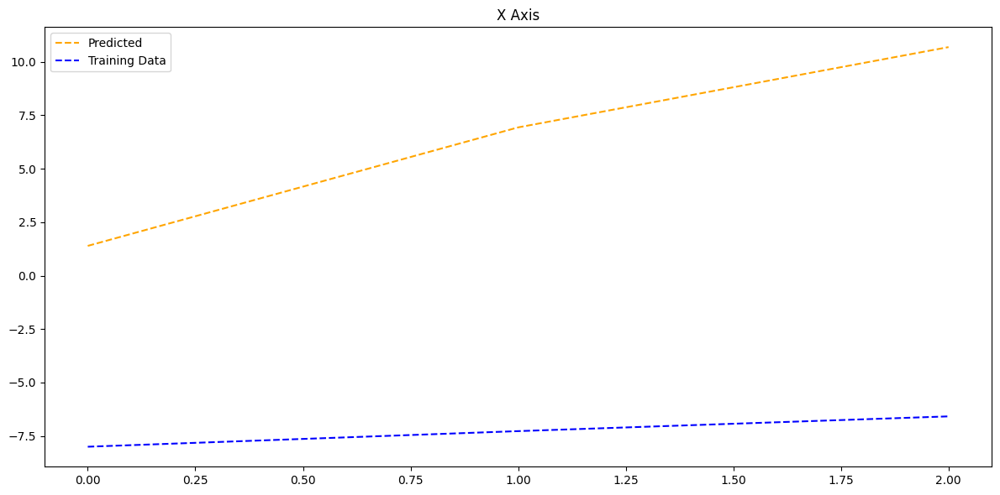

In [64]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [65]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = output
            predictions = torch.stack(predictions)

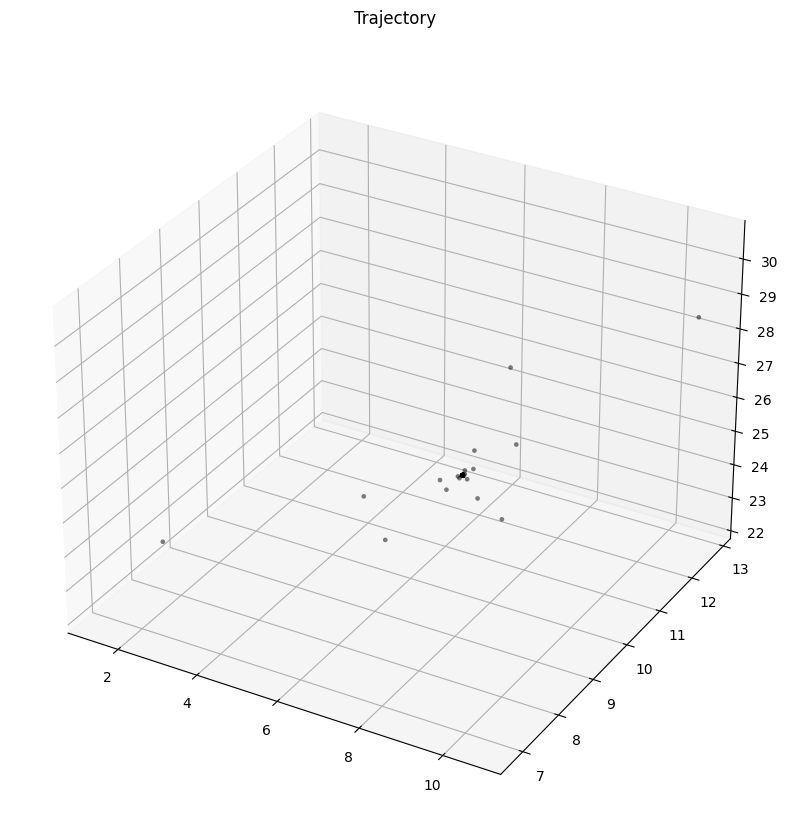

In [66]:
visualize_3d(obs = predictions)

In [67]:
true_lorenz_tensor[0]

tensor([[-8.,  7., 27.]])

In [68]:
predicted_lorenz.shape

torch.Size([50, 1, 3])

In [69]:
predictions.shape

torch.Size([5000, 1, 3])

In [70]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [71]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

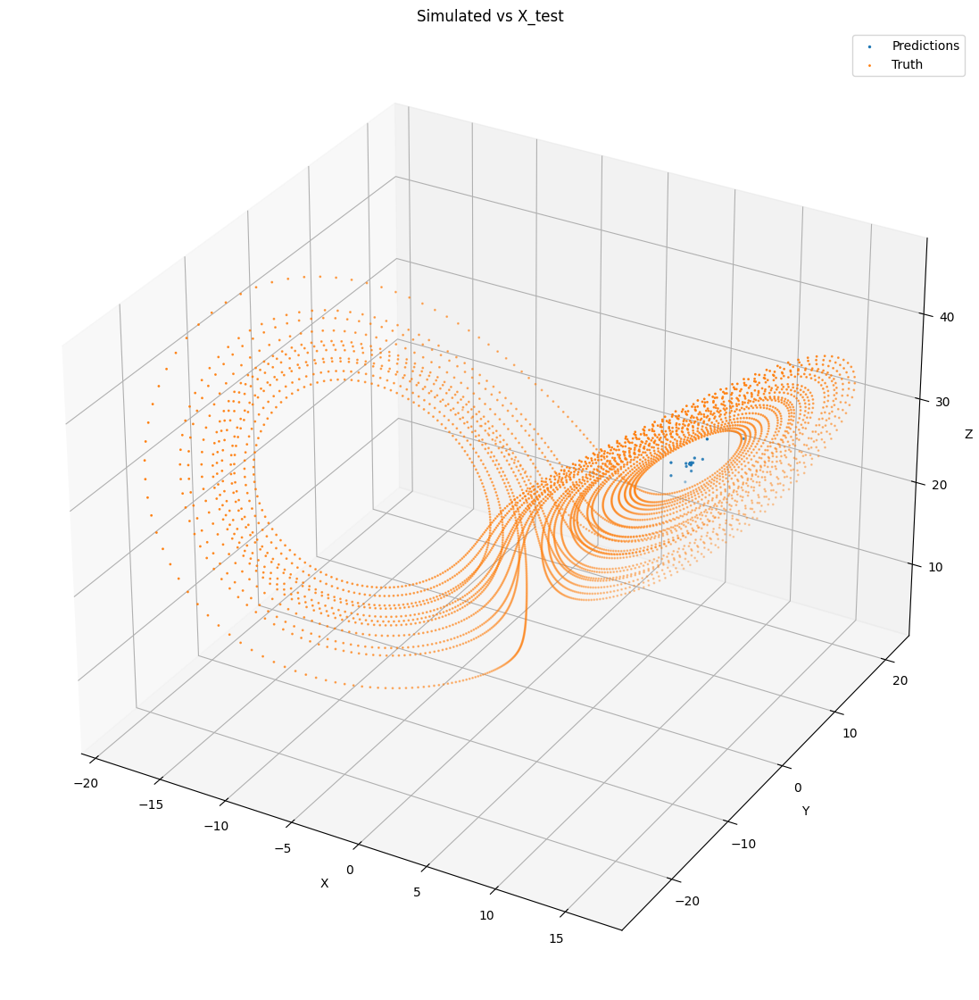

In [72]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

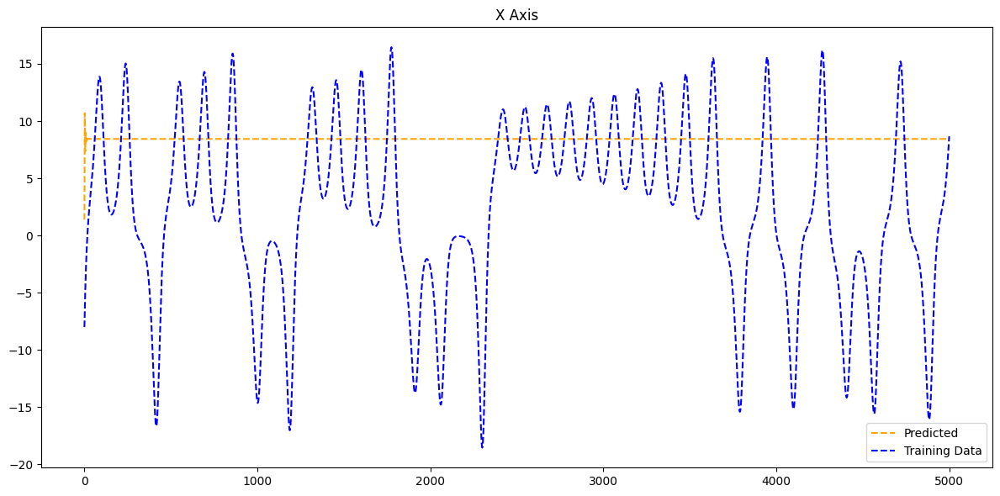

In [73]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

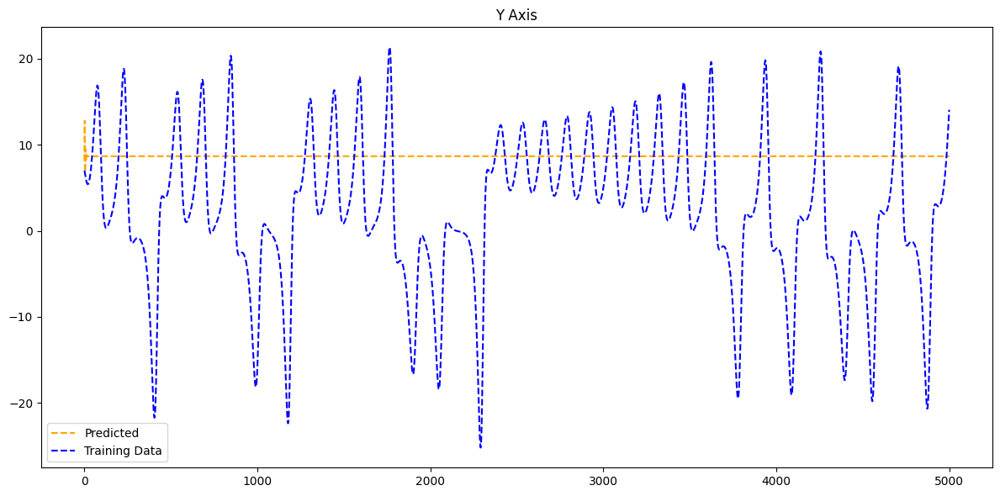

In [74]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(y_train, label='Training Data',color='blue',linestyle='--')
plt.title('Y Axis')
plt.legend()
plt.tight_layout()
plt.show()

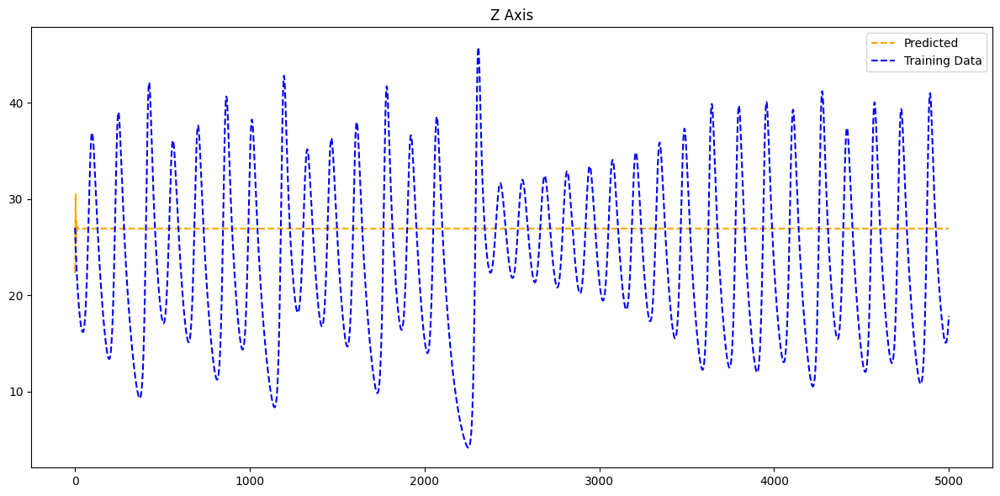

In [75]:
plt.figure(figsize=(12, 6))
plt.plot(z_pred, label='Predicted',linestyle='--',color='orange')
plt.plot(z_train, label='Training Data',color='blue',linestyle='--')
plt.title('Z Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [76]:
predictions = []
with torch.no_grad():
    for i in range(3):
        output = model(input_seq.unsqueeze(0))
        #output = output.squeeze(0)
        predictions.append(output)
        input_seq = output
predictions = torch.stack(predictions)

In [77]:
predictions = []
with torch.no_grad():
    for i in range(5000):
        output = model(input_seq.unsqueeze(0))
        #output = output.squeeze(0)
        predictions.append(output)
        input_seq = output
predictions = torch.stack(predictions)

In [78]:
predictions.shape

torch.Size([5000, 1, 3])

In [79]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [80]:
x_train = true_lorenz[:3, :, 0]
y_train = true_lorenz[:3, :, 1]
z_train = true_lorenz[:3, :, 2]

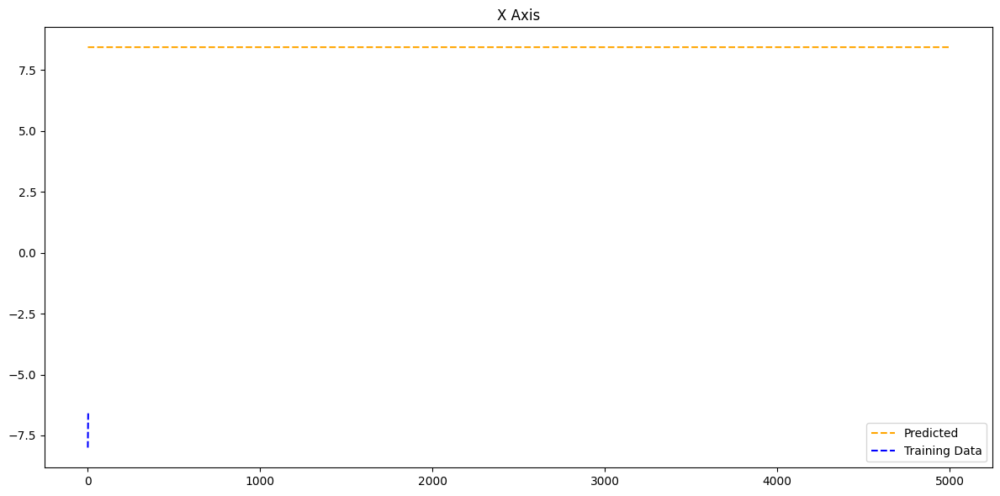

In [81]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [82]:
true_lorenz.shape

torch.Size([5000, 1, 3])

In [83]:
true_lorenz[0]

tensor([[-8.,  7., 27.]])

In [84]:
true_lorenz[0].unsqueeze(0)

tensor([[[-8.,  7., 27.]]])

In [85]:
true_lorenz[0].unsqueeze(0).shape

torch.Size([1, 1, 3])

In [86]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                input_seq = true_lorenz[i]
            predictions = torch.stack(predictions)

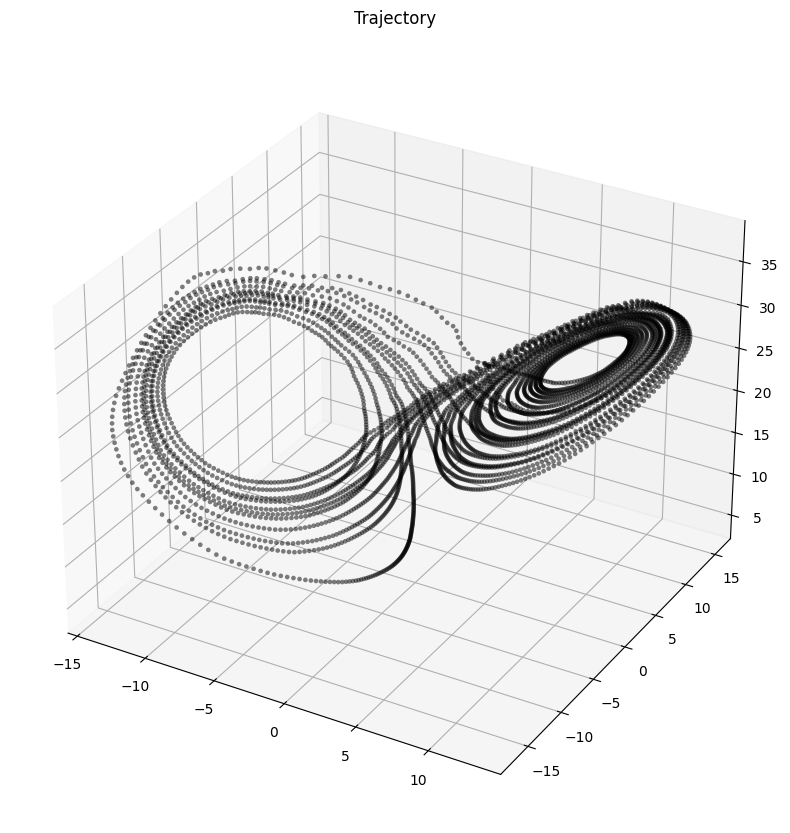

In [87]:
visualize_3d(obs = predictions)

In [88]:
predictions.shape

torch.Size([5000, 1, 3])

In [89]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [90]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

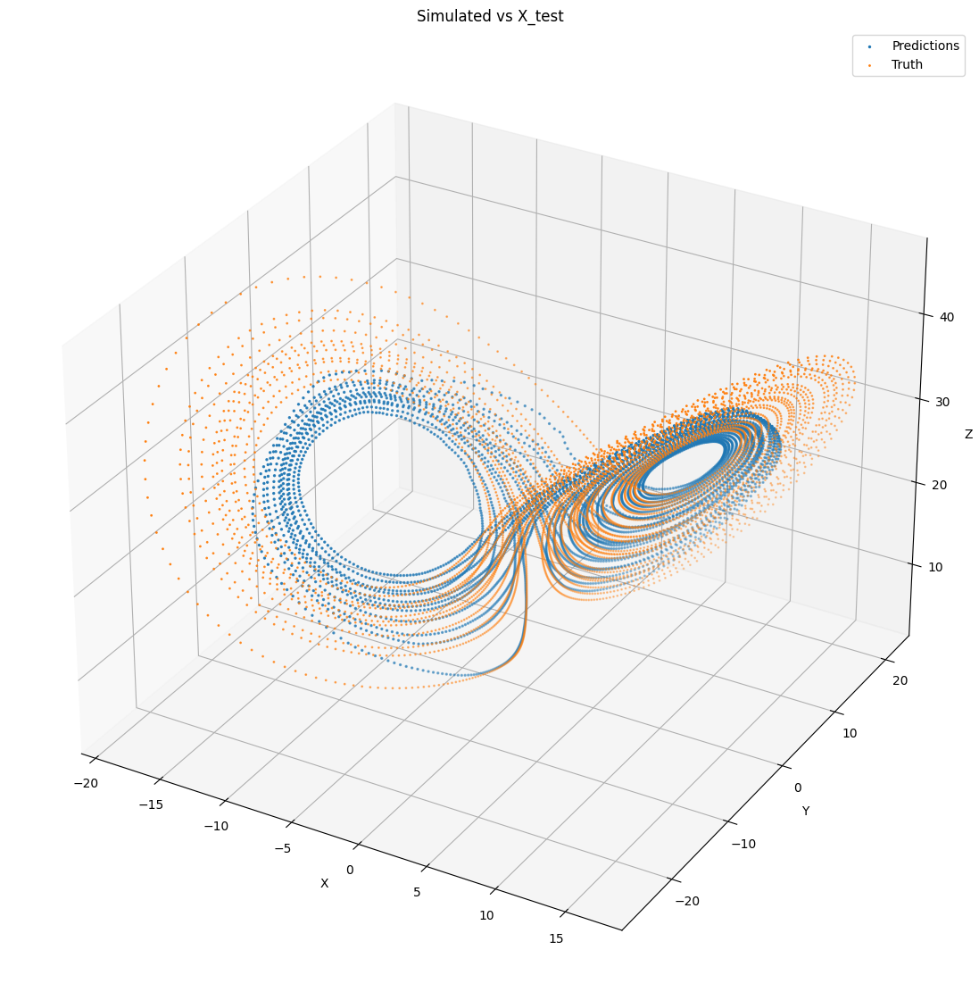

In [91]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

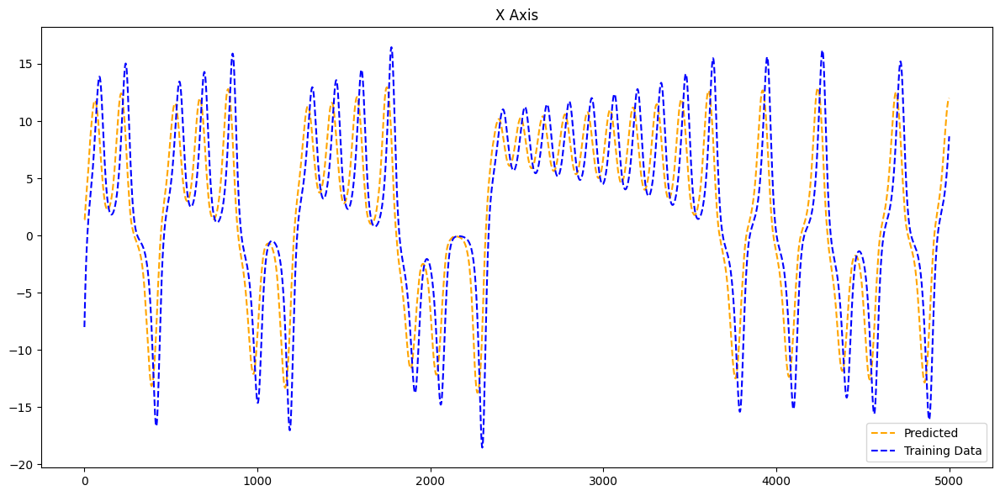

In [92]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [93]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                if i % 2 == 0:
                    input_seq = true_lorenz[i]
                else:
                    input_seq = output
                
            predictions = torch.stack(predictions)

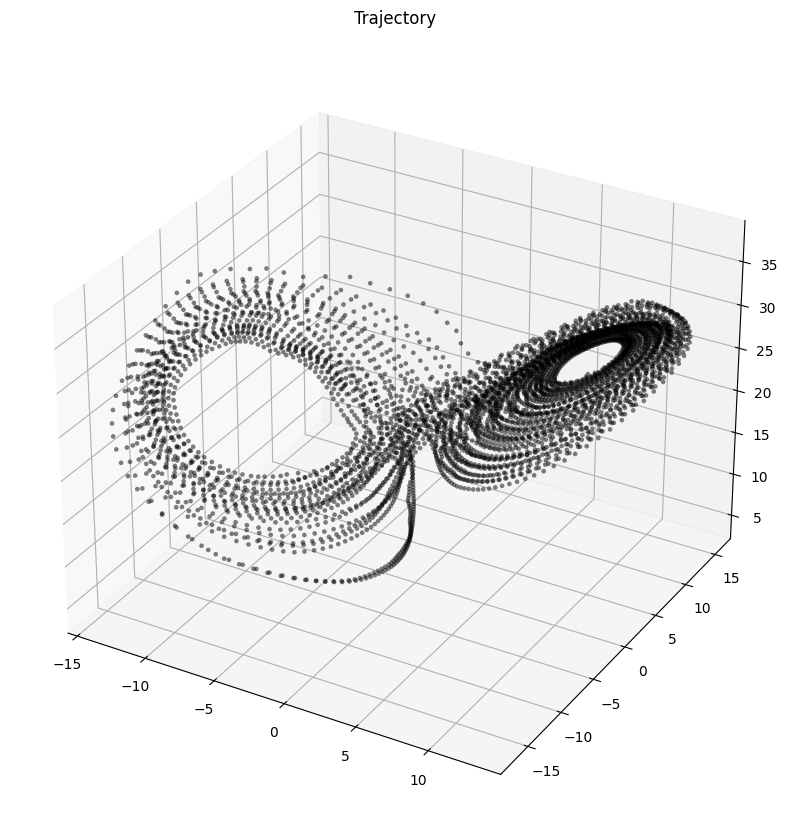

In [94]:
visualize_3d(obs = predictions)

In [95]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [96]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

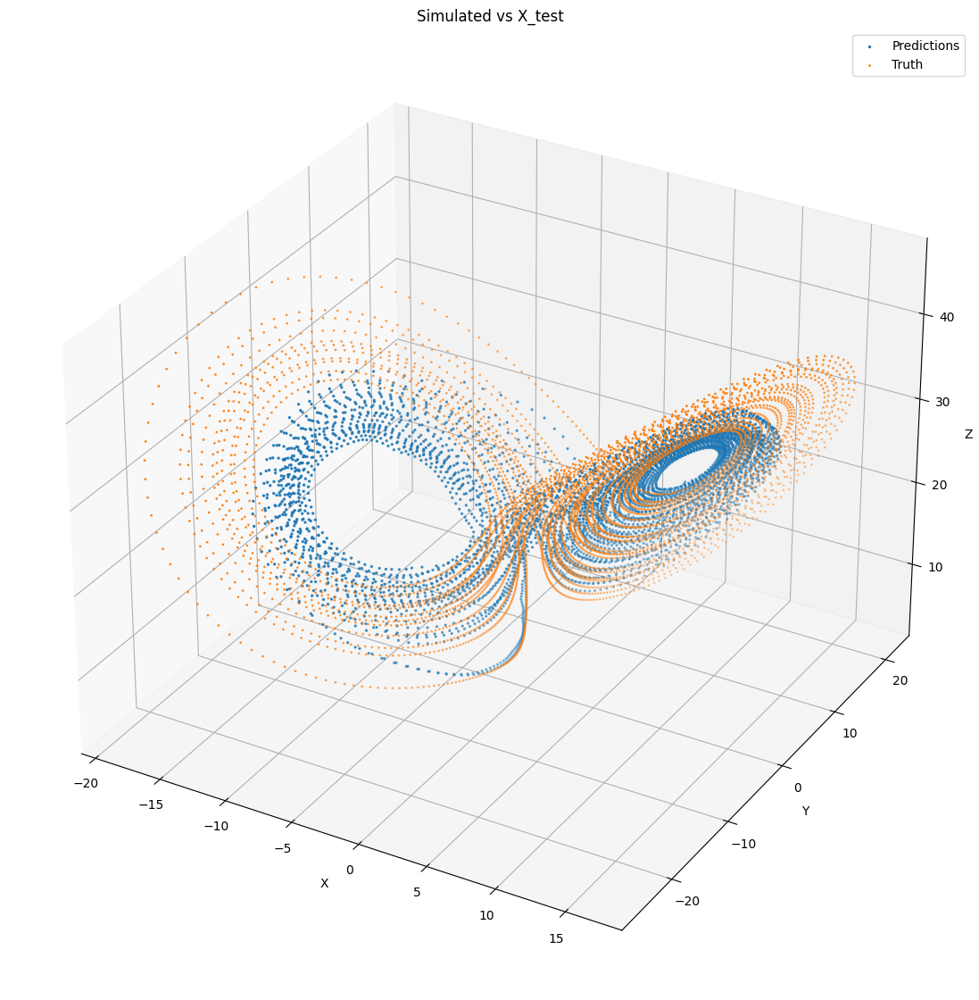

In [97]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

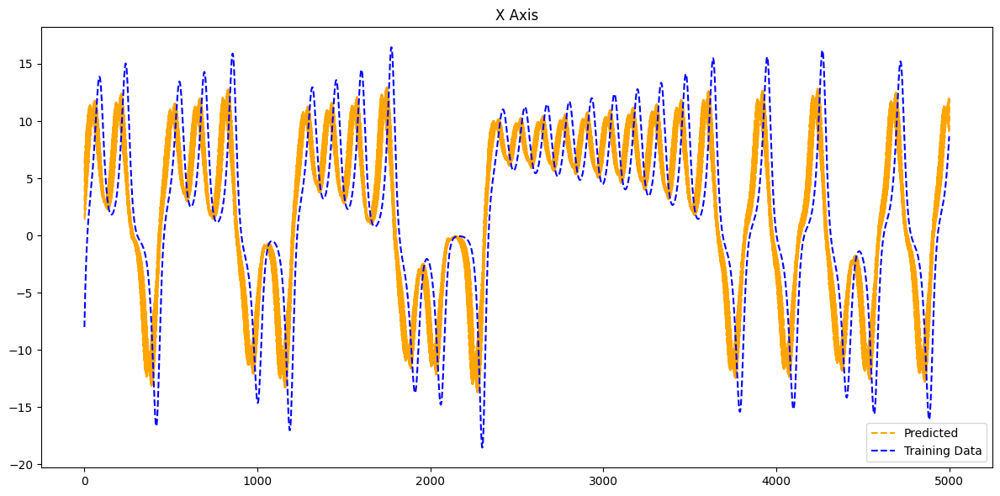

In [98]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

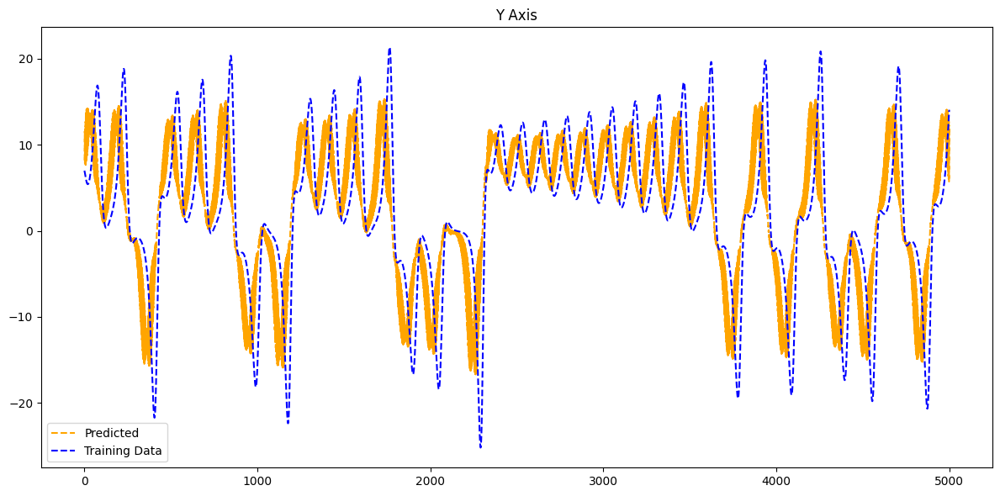

In [99]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(y_train, label='Training Data',color='blue',linestyle='--')
plt.title('Y Axis')
plt.legend()
plt.tight_layout()
plt.show()

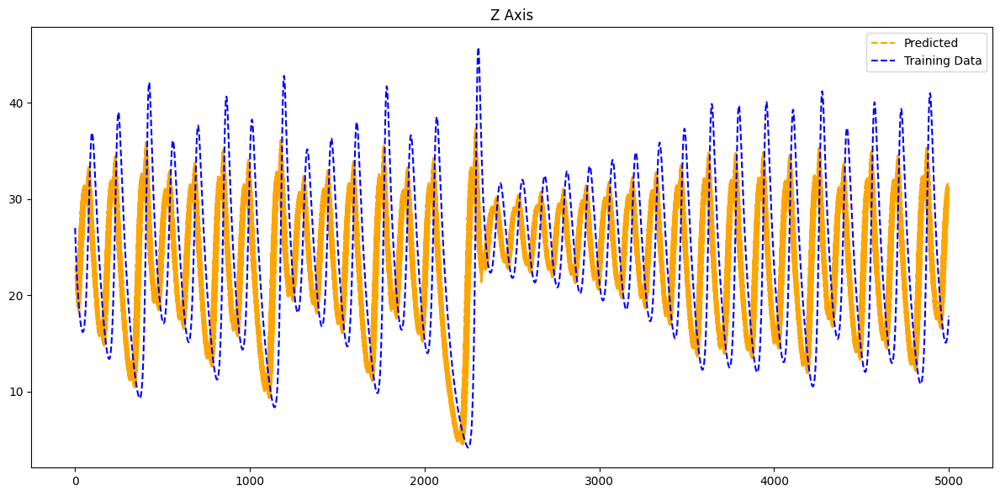

In [100]:
plt.figure(figsize=(12, 6))
plt.plot(z_pred, label='Predicted',linestyle='--',color='orange')
plt.plot(z_train, label='Training Data',color='blue',linestyle='--')
plt.title('Z Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [101]:
c = 0
for i in range(5000):
    if i % 2 == 0:
        c += 1

In [102]:
c

2500

In [103]:
c = 0
for i in range(5000):
    if i % 3 == 0:
        c += 1

In [104]:
c

1667

In [105]:
c = 0
for i in range(5000):
    if i % 4 == 0:
        c += 1

In [106]:
c

1250

In [107]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                if i % 4 == 0:
                    input_seq = true_lorenz[i]
                else:
                    input_seq = output
                
            predictions = torch.stack(predictions)

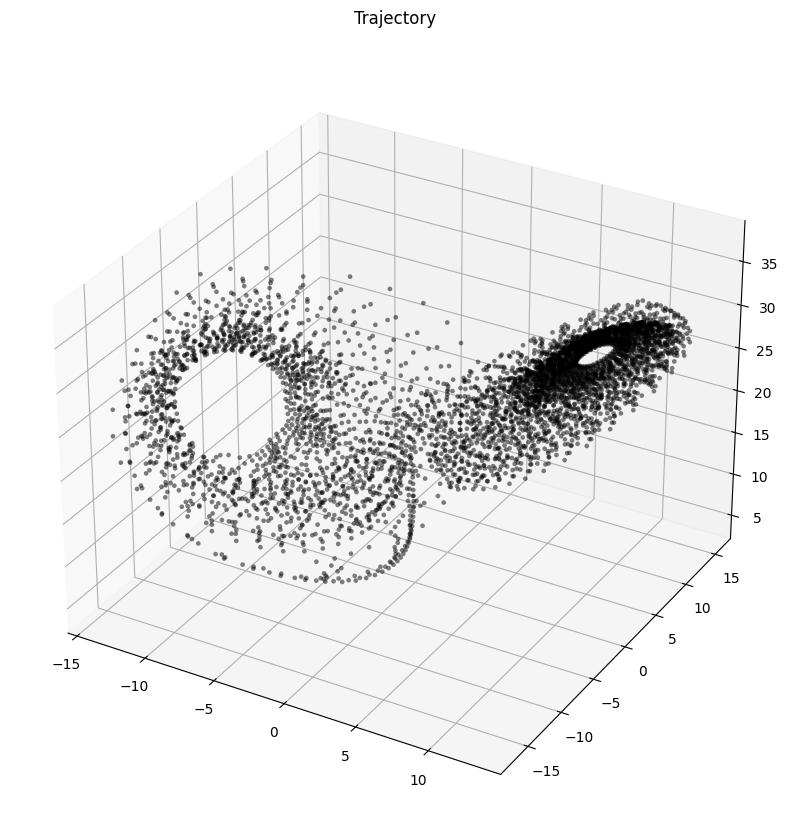

In [108]:
visualize_3d(obs = predictions)

In [109]:
true_lorenz_tensor[0]

tensor([[-8.,  7., 27.]])

In [110]:
input_seq = true_y0

In [111]:
predictions.shape

torch.Size([5000, 1, 3])

In [112]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [113]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

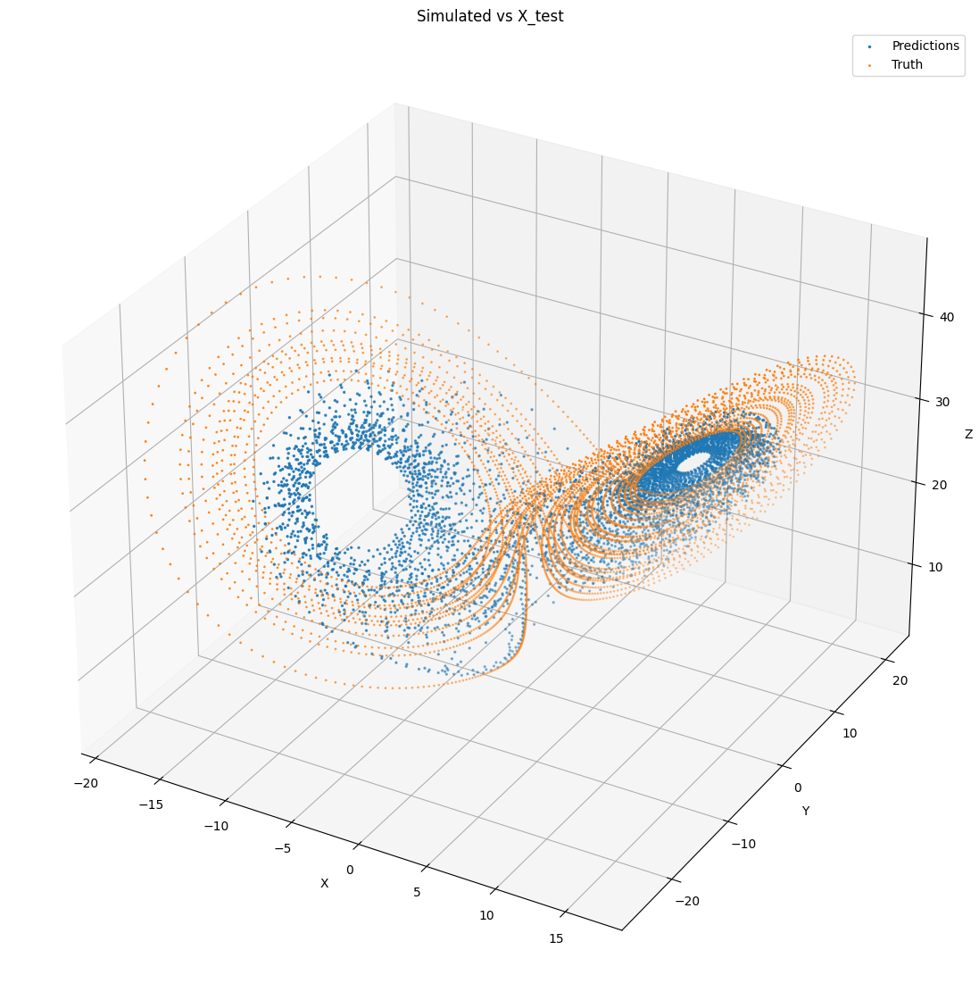

In [114]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

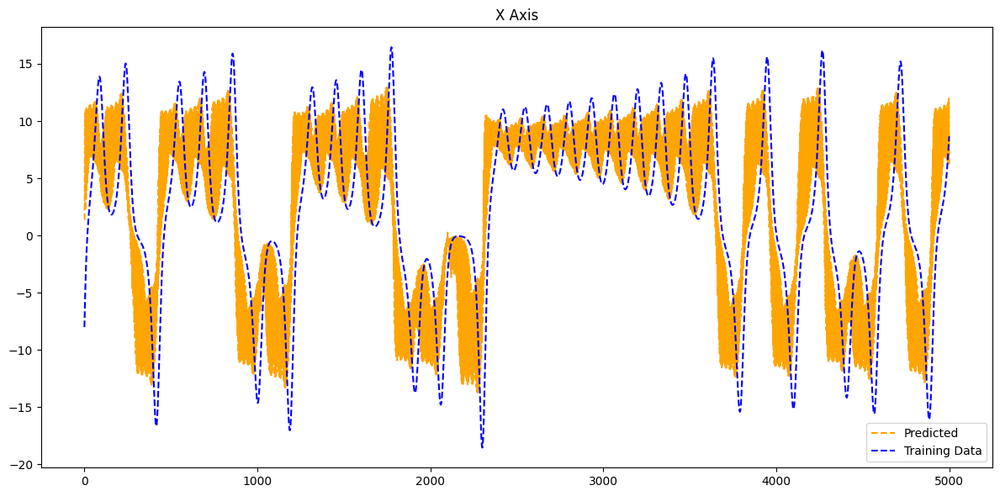

In [115]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [116]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                if i % 10 == 0:
                    input_seq = true_lorenz[i]
                else:
                    input_seq = output
                
            predictions = torch.stack(predictions)

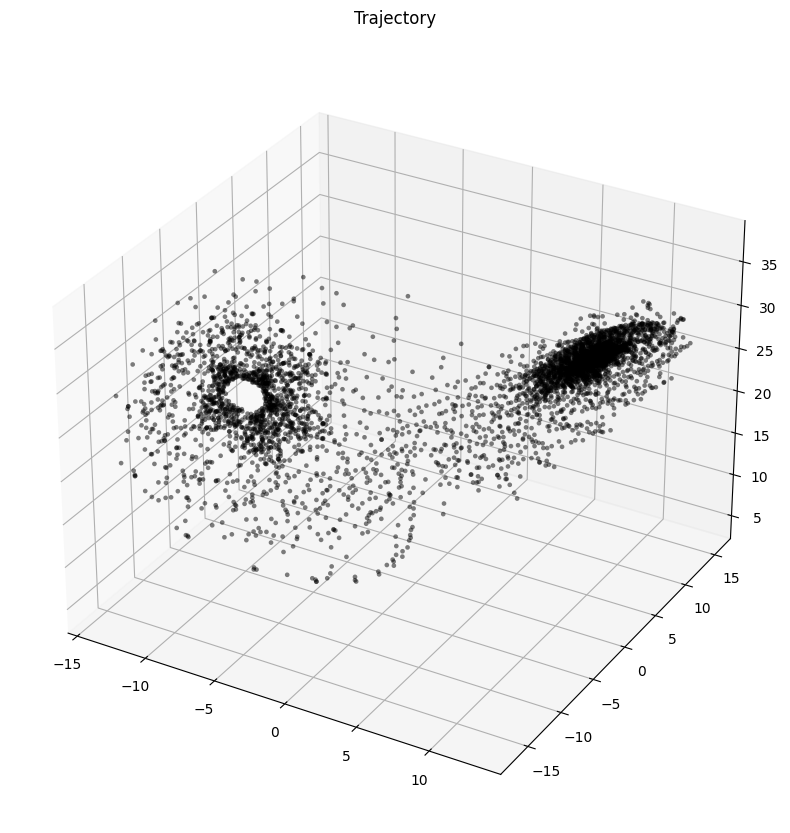

In [117]:
visualize_3d(obs = predictions)

In [118]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [119]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

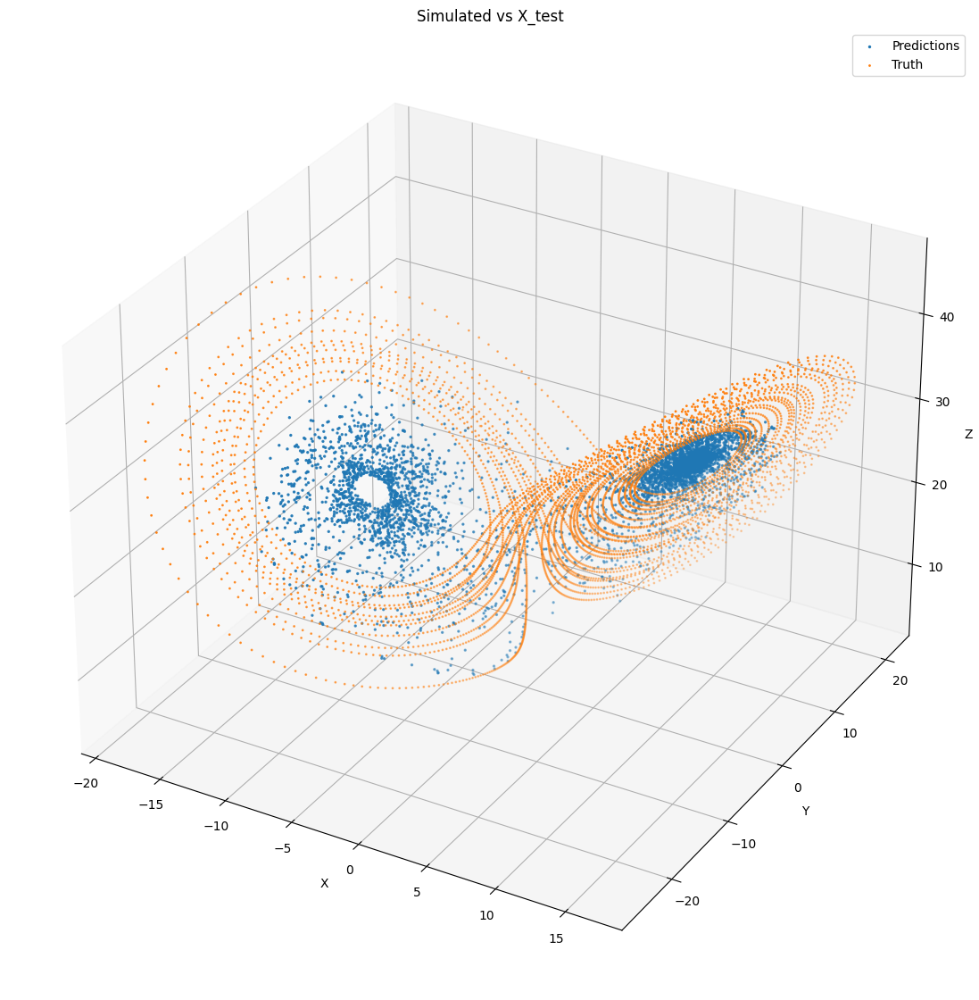

In [120]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

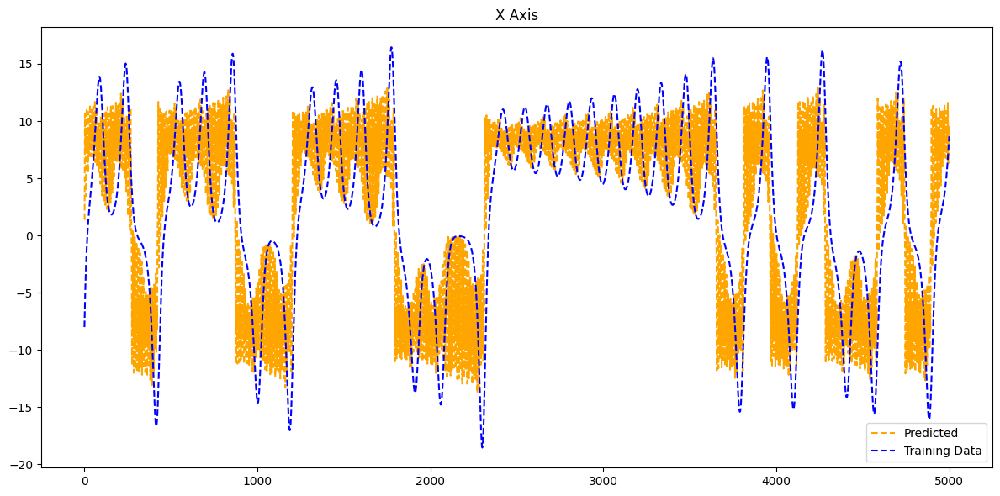

In [121]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [122]:
c = 0
for i in range(5000):
    if i % 20 == 0:
        c += 1

In [123]:
c

250

In [124]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                if i % 20 == 0:
                    input_seq = true_lorenz[i]
                else:
                    input_seq = output
                
            predictions = torch.stack(predictions)

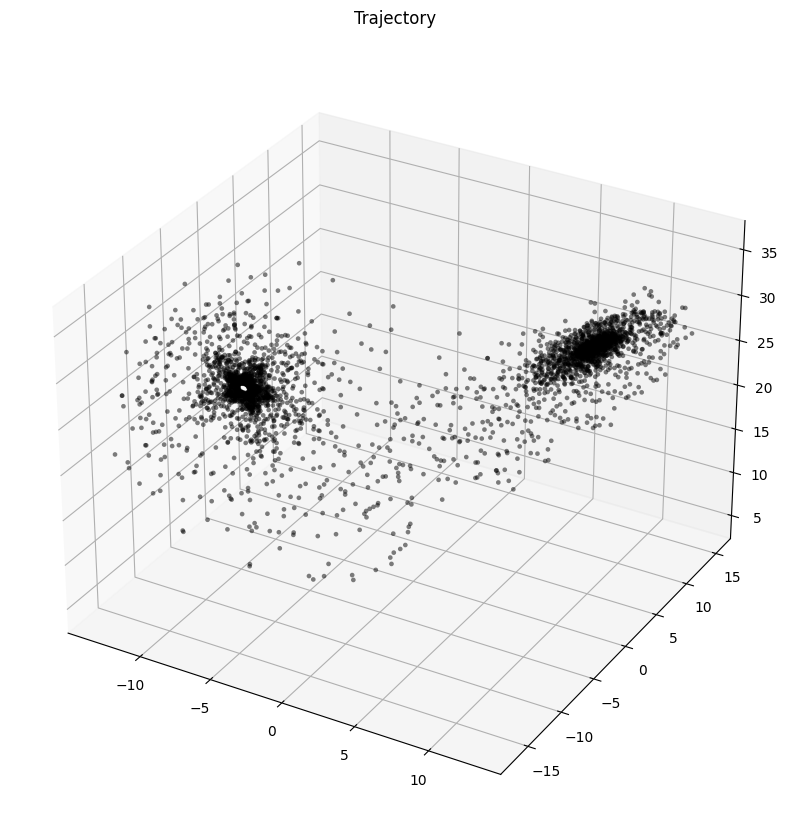

In [125]:
visualize_3d(obs = predictions)

In [126]:
predictions.shape

torch.Size([5000, 1, 3])

In [127]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [128]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

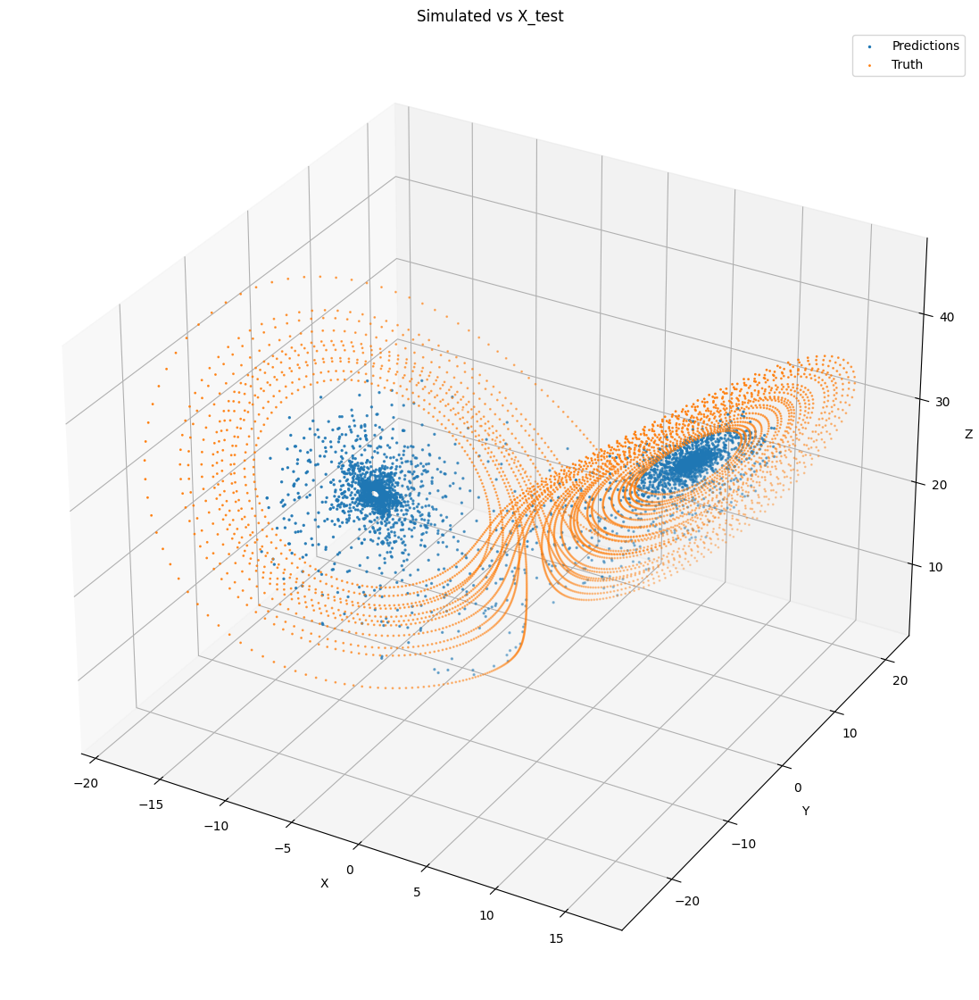

In [129]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

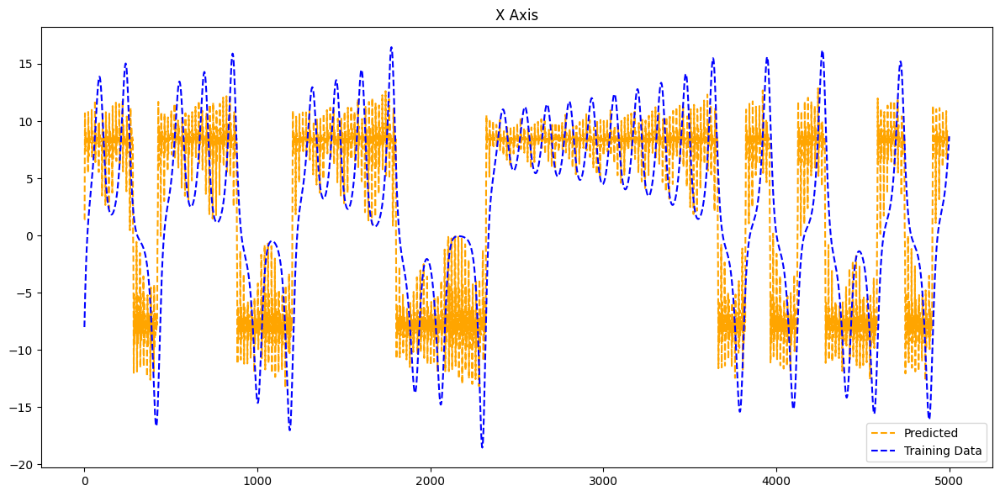

In [130]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

In [131]:
predictions = []
with torch.no_grad():
            input_seq = true_lorenz[0]
            for i in range(5000):
                output = model(input_seq.unsqueeze(0))
                predictions.append(output)
                if i % 50 == 0:
                    input_seq = true_lorenz[i]
                else:
                    input_seq = output
                
            predictions = torch.stack(predictions)

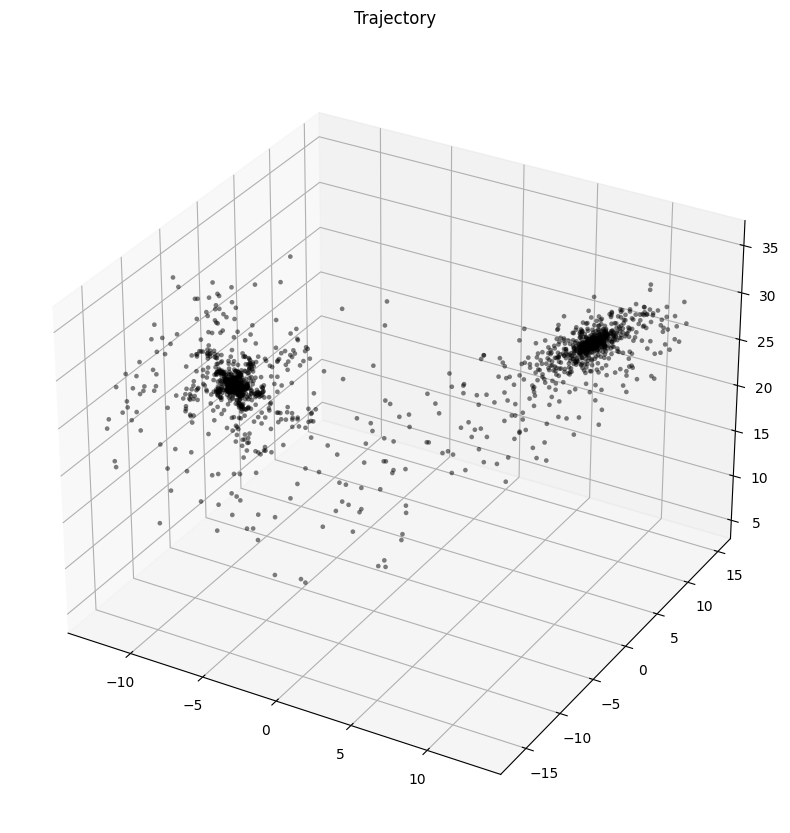

In [132]:
visualize_3d(obs = predictions)

In [133]:
x_pred = predictions[:,:, 0]
y_pred = predictions[:, :,1]
z_pred = predictions[:, :,2]

In [134]:
x_train = true_lorenz[:, :, 0]
y_train = true_lorenz[:, :, 1]
z_train = true_lorenz[:, :, 2]

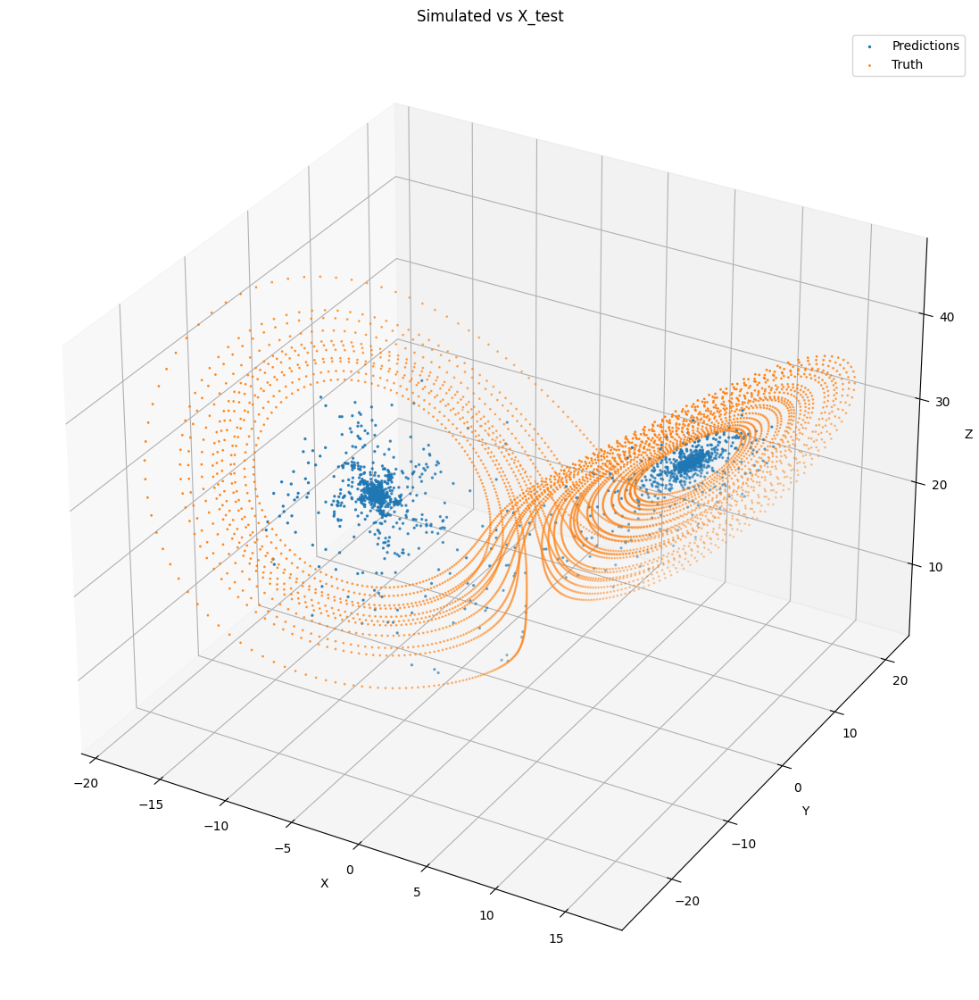

In [135]:
# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='Truth',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

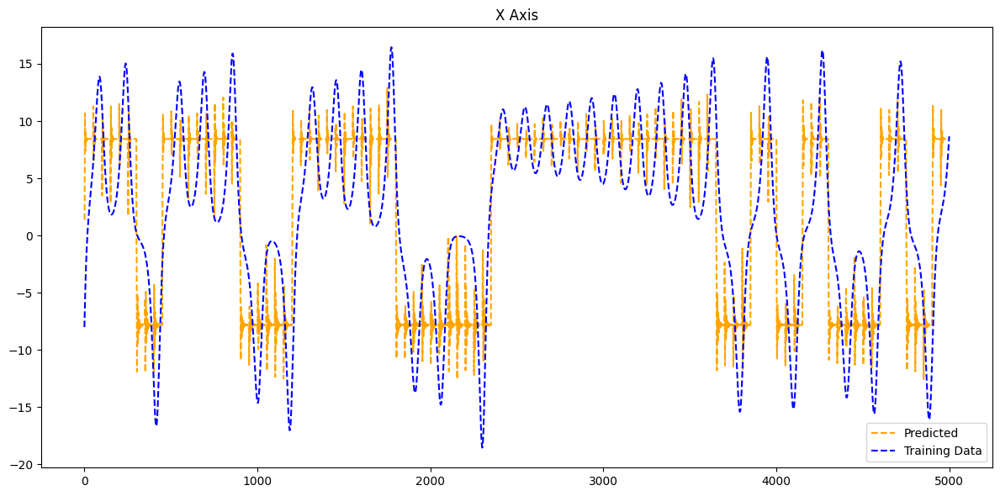

In [136]:
plt.figure(figsize=(12, 6))
plt.plot(x_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(x_train, label='Training Data',color='blue',linestyle='--')
plt.title('X Axis')
plt.legend()

plt.tight_layout()
plt.show()

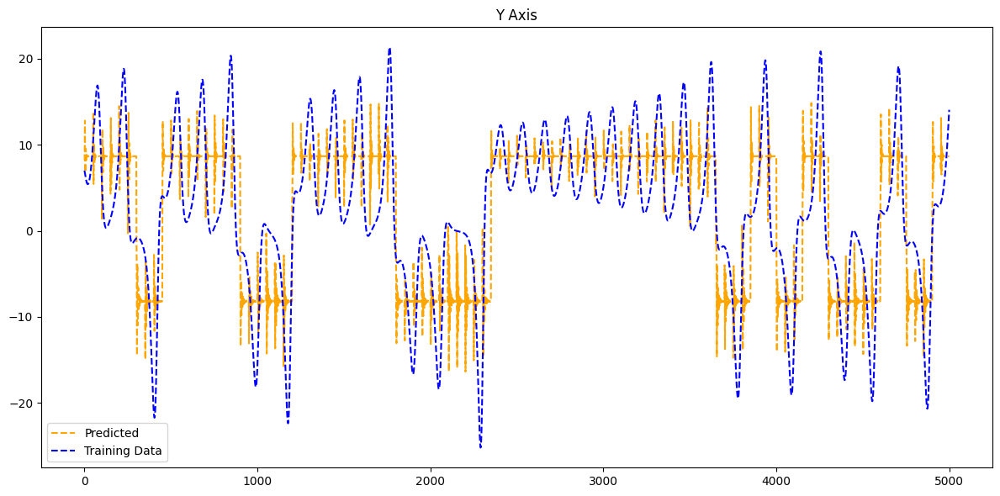

In [137]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred, label='Predicted',color='orange',linestyle='--')
plt.plot(y_train, label='Training Data',color='blue',linestyle='--')
plt.title('Y Axis')
plt.legend()
plt.tight_layout()
plt.show()

In [138]:
x.shape

torch.Size([50, 1, 3])

In [139]:
x

tensor([[[ 11.2351,   5.0978,  36.3662]],

        [[  7.9728,   1.5567,  33.2395]],

        [[ 13.8365,   8.4032,  38.9804]],

        [[  9.7716,   1.4182,  36.4989]],

        [[  7.7179,  -0.2207,  34.2597]],

        [[  1.1354,   3.8093,  23.6188]],

        [[  9.4594,   3.4262,  34.3510]],

        [[  3.3748,  -0.2634,  26.9099]],

        [[  6.0271,  10.8904,  11.9649]],

        [[ -0.5909,  -2.5323,  22.0652]],

        [[ -2.0712,  -3.4709,  17.2640]],

        [[ -3.2579,  -5.3738,  15.0690]],

        [[ -4.5176,   0.7697,  29.4810]],

        [[ -0.6406,  -1.0282,  12.6736]],

        [[  4.7764,   7.2626,  18.4344]],

        [[  9.2640,   3.9140,  33.5641]],

        [[  3.9375,   2.0042,  24.9932]],

        [[  4.4437,   6.5986,  17.0877]],

        [[ 12.7932,   9.1063,  36.1874]],

        [[  3.0429,   1.1571,  24.2189]],

        [[ 16.1601,  19.3175,  34.4344]],

        [[ -5.5989,  -0.6882,  29.8571]],

        [[ -3.3582,  -5.4062,  14.5691]],

        [[ 

In [140]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)
    batch_t = t[:batch_size]  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_t, batch_y

In [141]:
c,v,b = get_batch(true_lorenz_tensor, batch_size=5)

In [142]:
c

tensor([[[ -0.7931,  -3.4705,  23.6851]],

        [[ -7.3003, -12.3409,  15.3507]],

        [[-14.1644, -14.4090,  34.3576]],

        [[ -2.1029,  -0.3453,  23.3121]],

        [[ -3.2992,  -5.9712,  10.9017]]])

In [143]:
true_lorenz_tensor[1826]

tensor([[-0.7931, -3.4705, 23.6851]])

In [144]:
true_lorenz_tensor[2029]

tensor([[ -7.3003, -12.3409,  15.3507]])

In [145]:
true_lorenz_tensor[4834]

tensor([[-3.2992, -5.9712, 10.9017]])

In [146]:
b

tensor([[[[ -0.7931,  -3.4705,  23.6851]],

         [[ -7.3003, -12.3409,  15.3507]],

         [[-14.1644, -14.4090,  34.3576]],

         [[ -2.1029,  -0.3453,  23.3121]],

         [[ -3.2992,  -5.9712,  10.9017]]],


        [[[ -0.9237,  -3.4723,  23.3862]],

         [[ -7.5561, -12.7433,  15.6102]],

         [[-14.1632, -13.8685,  34.8976]],

         [[ -2.0183,  -0.3933,  23.0070]],

         [[ -3.4358,  -6.2289,  10.8594]]],


        [[[ -1.0481,  -3.4784,  23.0934]],

         [[ -7.8191, -13.1494,  15.8979]],

         [[-14.1348, -13.2947,  35.3902]],

         [[ -1.9403,  -0.4421,  22.7063]],

         [[ -3.5786,  -6.4980,  10.8264]]],


        [[[ -1.1669,  -3.4890,  22.8066]],

         [[ -8.0891, -13.5577,  16.2149]],

         [[-14.0791, -12.6923,  35.8322]],

         [[ -1.8684,  -0.4916,  22.4099]],

         [[ -3.7279,  -6.7788,  10.8034]]],


        [[[ -1.2806,  -3.5042,  22.5258]],

         [[ -8.3659, -13.9666,  16.5626]],

         [[-13.9961, -12

In [147]:
c

tensor([[[ -0.7931,  -3.4705,  23.6851]],

        [[ -7.3003, -12.3409,  15.3507]],

        [[-14.1644, -14.4090,  34.3576]],

        [[ -2.1029,  -0.3453,  23.3121]],

        [[ -3.2992,  -5.9712,  10.9017]]])

In [148]:
b

tensor([[[[ -0.7931,  -3.4705,  23.6851]],

         [[ -7.3003, -12.3409,  15.3507]],

         [[-14.1644, -14.4090,  34.3576]],

         [[ -2.1029,  -0.3453,  23.3121]],

         [[ -3.2992,  -5.9712,  10.9017]]],


        [[[ -0.9237,  -3.4723,  23.3862]],

         [[ -7.5561, -12.7433,  15.6102]],

         [[-14.1632, -13.8685,  34.8976]],

         [[ -2.0183,  -0.3933,  23.0070]],

         [[ -3.4358,  -6.2289,  10.8594]]],


        [[[ -1.0481,  -3.4784,  23.0934]],

         [[ -7.8191, -13.1494,  15.8979]],

         [[-14.1348, -13.2947,  35.3902]],

         [[ -1.9403,  -0.4421,  22.7063]],

         [[ -3.5786,  -6.4980,  10.8264]]],


        [[[ -1.1669,  -3.4890,  22.8066]],

         [[ -8.0891, -13.5577,  16.2149]],

         [[-14.0791, -12.6923,  35.8322]],

         [[ -1.8684,  -0.4916,  22.4099]],

         [[ -3.7279,  -6.7788,  10.8034]]],


        [[[ -1.2806,  -3.5042,  22.5258]],

         [[ -8.3659, -13.9666,  16.5626]],

         [[-13.9961, -12

In [149]:
b.shape

torch.Size([5, 5, 1, 3])

In [150]:
n = model(c)

In [151]:
n.shape

torch.Size([5, 1, 3])

In [152]:
n

tensor([[[ -3.4251,  -5.8320,  18.3916]],

        [[-12.0238, -13.4218,  28.8064]],

        [[ -8.2593,  -3.4127,  32.7112]],

        [[ -1.7784,  -2.0367,  17.3094]],

        [[ -9.5057, -14.5545,  18.5997]]], grad_fn=<SqueezeBackward1>)

In [153]:
loss = criterion(n,b)

In [154]:
b.shape

torch.Size([5, 5, 1, 3])

In [155]:
n = model(c)
n.shape

torch.Size([5, 1, 3])

In [156]:
v

tensor([0.0000, 0.0050, 0.0100, 0.0150, 0.0200])

In [157]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_y

In [158]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [159]:
b.shape

torch.Size([5, 5, 1, 3])

In [160]:
b

tensor([[[[ 2.2109, -1.3536, 26.1720]],

         [[ 3.2162,  3.1127, 21.0487]],

         [[-0.0934, -0.1691,  8.9249]],

         [[ 6.5691,  8.2898, 21.8015]],

         [[-2.1029, -0.3453, 23.3121]]],


        [[[ 2.0377, -1.3256, 25.8112]],

         [[ 3.2135,  3.2105, 20.8204]],

         [[-0.0973, -0.1774,  8.8068]],

         [[ 6.6570,  8.4532, 21.7877]],

         [[-2.0183, -0.3933, 23.0070]]],


        [[[ 1.8743, -1.2959, 25.4565]],

         [[ 3.2159,  3.3114, 20.5966]],

         [[-0.1014, -0.1860,  8.6902]],

         [[ 6.7487,  8.6188, 21.7833]],

         [[-1.9403, -0.4421, 22.7063]]],


        [[[ 1.7205, -1.2651, 25.1079]],

         [[ 3.2231,  3.4155, 20.3776]],

         [[-0.1058, -0.1951,  8.5751]],

         [[ 6.8441,  8.7865, 21.7885]],

         [[-1.8684, -0.4916, 22.4099]]],


        [[[ 1.5756, -1.2336, 24.7650]],

         [[ 3.2351,  3.5230, 20.1633]],

         [[-0.1104, -0.2047,  8.4616]],

         [[ 6.9430,  8.9561, 21.8037]],

        

In [161]:
true_lorenz_tensor[287]

tensor([[ 1.4393, -1.2019, 24.4278]])

In [162]:
true_lorenz_tensor[283]

tensor([[ 2.0377, -1.3256, 25.8112]])

In [163]:
c

tensor([[[ 2.2109, -1.3536, 26.1720]],

        [[ 3.2162,  3.1127, 21.0487]],

        [[-0.0934, -0.1691,  8.9249]],

        [[ 6.5691,  8.2898, 21.8015]],

        [[-2.1029, -0.3453, 23.3121]]])

In [164]:
b

tensor([[[[ 2.2109, -1.3536, 26.1720]],

         [[ 3.2162,  3.1127, 21.0487]],

         [[-0.0934, -0.1691,  8.9249]],

         [[ 6.5691,  8.2898, 21.8015]],

         [[-2.1029, -0.3453, 23.3121]]],


        [[[ 2.0377, -1.3256, 25.8112]],

         [[ 3.2135,  3.2105, 20.8204]],

         [[-0.0973, -0.1774,  8.8068]],

         [[ 6.6570,  8.4532, 21.7877]],

         [[-2.0183, -0.3933, 23.0070]]],


        [[[ 1.8743, -1.2959, 25.4565]],

         [[ 3.2159,  3.3114, 20.5966]],

         [[-0.1014, -0.1860,  8.6902]],

         [[ 6.7487,  8.6188, 21.7833]],

         [[-1.9403, -0.4421, 22.7063]]],


        [[[ 1.7205, -1.2651, 25.1079]],

         [[ 3.2231,  3.4155, 20.3776]],

         [[-0.1058, -0.1951,  8.5751]],

         [[ 6.8441,  8.7865, 21.7885]],

         [[-1.8684, -0.4916, 22.4099]]],


        [[[ 1.5756, -1.2336, 24.7650]],

         [[ 3.2351,  3.5230, 20.1633]],

         [[-0.1104, -0.2047,  8.4616]],

         [[ 6.9430,  8.9561, 21.8037]],

        

In [165]:
b[0]

tensor([[[ 2.2109, -1.3536, 26.1720]],

        [[ 3.2162,  3.1127, 21.0487]],

        [[-0.0934, -0.1691,  8.9249]],

        [[ 6.5691,  8.2898, 21.8015]],

        [[-2.1029, -0.3453, 23.3121]]])

In [166]:
b[4]

tensor([[[ 1.5756, -1.2336, 24.7650]],

        [[ 3.2351,  3.5230, 20.1633]],

        [[-0.1104, -0.2047,  8.4616]],

        [[ 6.9430,  8.9561, 21.8037]],

        [[-1.8025, -0.5417, 22.1178]]])

In [167]:
b.shape

torch.Size([5, 5, 1, 3])

In [168]:
b[:,0,:]

tensor([[[ 2.2109, -1.3536, 26.1720]],

        [[ 2.0377, -1.3256, 25.8112]],

        [[ 1.8743, -1.2959, 25.4565]],

        [[ 1.7205, -1.2651, 25.1079]],

        [[ 1.5756, -1.2336, 24.7650]]])

In [169]:
b[:,1,:]

tensor([[[ 3.2162,  3.1127, 21.0487]],

        [[ 3.2135,  3.2105, 20.8204]],

        [[ 3.2159,  3.3114, 20.5966]],

        [[ 3.2231,  3.4155, 20.3776]],

        [[ 3.2351,  3.5230, 20.1633]]])

In [170]:
b[:,0,:]

tensor([[[ 2.2109, -1.3536, 26.1720]],

        [[ 2.0377, -1.3256, 25.8112]],

        [[ 1.8743, -1.2959, 25.4565]],

        [[ 1.7205, -1.2651, 25.1079]],

        [[ 1.5756, -1.2336, 24.7650]]])

In [171]:
true_lorenz_tensor[287]

tensor([[ 1.4393, -1.2019, 24.4278]])

In [172]:
b[:,0,:]

tensor([[[ 2.2109, -1.3536, 26.1720]],

        [[ 2.0377, -1.3256, 25.8112]],

        [[ 1.8743, -1.2959, 25.4565]],

        [[ 1.7205, -1.2651, 25.1079]],

        [[ 1.5756, -1.2336, 24.7650]]])

In [173]:
true_lorenz_tensor[288]

tensor([[ 1.3113, -1.1703, 24.0961]])

In [174]:
true_lorenz_tensor[283]

tensor([[ 2.0377, -1.3256, 25.8112]])

In [175]:
true_lorenz_tensor[284]

tensor([[ 1.8743, -1.2959, 25.4565]])

In [176]:
true_lorenz_tensor[286]

tensor([[ 1.5756, -1.2336, 24.7650]])

In [177]:
n = model(c)
n.shape

torch.Size([5, 1, 3])

In [178]:
n

tensor([[[ 0.2524, -0.8980, 19.1917]],

        [[ 5.0521,  7.3229, 18.1103]],

        [[-0.3392, -0.7671,  6.4321]],

        [[ 9.2235, 11.1057, 25.2357]],

        [[-1.7784, -2.0367, 17.3094]]], grad_fn=<SqueezeBackward1>)

In [179]:
n = model(c)
n.shape

torch.Size([5, 1, 3])

In [180]:
n

tensor([[[ 0.2524, -0.8980, 19.1917]],

        [[ 5.0521,  7.3229, 18.1103]],

        [[-0.3392, -0.7671,  6.4321]],

        [[ 9.2235, 11.1057, 25.2357]],

        [[-1.7784, -2.0367, 17.3094]]], grad_fn=<SqueezeBackward1>)

In [181]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = [true_y[indices + i] for i in range(batch_size)]  # (batch_size, M, D)
    return batch_y0, batch_y

In [182]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [183]:
b

[tensor([[[-2.4318,  0.9525, 26.0409]],
 
         [[ 5.7921,  6.4355, 22.7222]],
 
         [[11.4091,  9.7010, 32.5713]],
 
         [[13.5938, 16.7019, 30.2857]],
 
         [[-0.8974, -2.1101, 19.3351]]]),
 tensor([[[-2.2674,  0.9228, 25.6849]],
 
         [[ 5.8265,  6.5580, 22.6087]],
 
         [[11.3181,  9.3903, 32.6788]],
 
         [[13.7391, 16.4379, 31.0099]],
 
         [[-0.9573, -2.1403, 19.0888]]]),
 tensor([[[-2.1126,  0.8910, 25.3348]],
 
         [[ 5.8652,  6.6841, 22.5015]],
 
         [[11.2164,  9.0780, 32.7628]],
 
         [[13.8632, 16.1243, 31.7155]],
 
         [[-1.0158, -2.1741, 18.8465]]]),
 tensor([[[-1.9669,  0.8577, 24.9903]],
 
         [[ 5.9083,  6.8137, 22.4007]],
 
         [[11.1044,  8.7657, 32.8234]],
 
         [[13.9648, 15.7621, 32.3978]],
 
         [[-1.0732, -2.2115, 18.6082]]]),
 tensor([[[-1.8299,  0.8233, 24.6514]],
 
         [[ 5.9558,  6.9468, 22.3067]],
 
         [[10.9827,  8.4551, 32.8610]],
 
         [[14.0426, 15.3531, 33.05

In [184]:
b.shape

In [185]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = true_y[indices:indices+batch_size+1]  # (batch_size, M, D)
    return batch_y0, batch_y

In [186]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [187]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_y

In [188]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [189]:
b.shape

torch.Size([5, 5, 1, 3])

In [190]:
b

tensor([[[[ 6.7308,  4.1242, 28.3222]],

         [[ 5.4224,  3.2656, 26.5649]],

         [[ 4.6706,  6.2444, 19.1636]],

         [[ 2.7235,  4.7310, 12.6675]],

         [[ 9.5939, 16.3473, 16.7778]]],


        [[[ 6.6030,  4.0969, 28.0831]],

         [[ 5.3178,  3.2913, 26.3005]],

         [[ 4.7517,  6.4221, 19.0579]],

         [[ 2.8261,  4.9203, 12.5662]],

         [[ 9.9344, 16.7982, 17.3596]]],


        [[[ 6.4802,  4.0776, 27.8439]],

         [[ 5.2197,  3.3230, 26.0386]],

         [[ 4.8377,  6.6052, 18.9606]],

         [[ 2.9331,  5.1181, 12.4715]],

         [[10.2801, 17.2353, 17.9842]]],


        [[[ 6.3627,  4.0661, 27.6049]],

         [[ 5.1281,  3.3604, 25.7795]],

         [[ 4.9285,  6.7935, 18.8719]],

         [[ 3.0447,  5.3248, 12.3838]],

         [[10.6297, 17.6543, 18.6522]]],


        [[[ 6.2506,  4.0620, 27.3665]],

         [[ 5.0429,  3.4032, 25.5234]],

         [[ 5.0242,  6.9872, 18.7922]],

         [[ 3.1612,  5.5405, 12.3035]],

        

In [191]:
b = b.reshape(5,1,3)

In [192]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.tensor([true_y[indices + i] for i in range(batch_size)])  # (batch_size, M, D)
    return batch_y0, batch_y

In [193]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [194]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = [true_y[indices + i] for i in range(batch_size)]  # (batch_size, M, D)
    return batch_y0, batch_y

In [195]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [196]:
b

[tensor([[[13.4788,  9.3059, 37.4902]],
 
         [[10.2424,  2.7684, 36.3194]],
 
         [[-2.9106, -4.6700, 18.4160]],
 
         [[13.7000,  6.6353, 40.0438]],
 
         [[ 5.3745,  9.8747, 10.9393]]]),
 tensor([[[13.2584,  8.6229, 37.5889]],
 
         [[ 9.8673,  2.3461, 35.9659]],
 
         [[-2.9993, -4.7893, 18.2415]],
 
         [[13.3345,  5.7934, 39.9305]],
 
         [[ 5.6042, 10.2908, 11.0693]]]),
 tensor([[[13.0157,  7.9497, 37.6318]],
 
         [[ 9.4907,  1.9586, 35.5928]],
 
         [[-3.0897, -4.9149, 18.0732]],
 
         [[12.9467,  4.9878, 39.7533]],
 
         [[ 5.8433, 10.7207, 11.2214]]]),
 tensor([[[12.7523,  7.2910, 37.6210]],
 
         [[ 9.1146,  1.6055, 35.2036]],
 
         [[-3.1819, -5.0469, 17.9114]],
 
         [[12.5395,  4.2228, 39.5181]],
 
         [[ 6.0920, 11.1639, 11.3971]]]),
 tensor([[[12.4700,  6.6510, 37.5593]],
 
         [[ 8.7403,  1.2855, 34.8013]],
 
         [[-3.2763, -5.1855, 17.7562]],
 
         [[12.1158,  3.5019, 39.23

In [197]:
n = model(c)
n.shape

torch.Size([5, 1, 3])

In [198]:
n

tensor([[[ 6.4229e+00,  1.4445e+00,  3.0595e+01]],

        [[ 3.9040e+00,  1.0864e-02,  2.7039e+01]],

        [[-6.3823e+00, -1.0071e+01,  1.8209e+01]],

        [[ 4.9766e+00, -9.4116e-01,  3.0066e+01]],

        [[ 1.2239e+01,  1.5008e+01,  2.5490e+01]]], grad_fn=<SqueezeBackward1>)

In [199]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_y

In [200]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [201]:
b.shape

torch.Size([5, 5, 1, 3])

In [202]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + batch_size-1]], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_y

In [203]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [204]:
b.shape

torch.Size([1, 5, 1, 3])

In [205]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + batch_size-1]], dim=1)  # (batch_size, M, D)
    return batch_y0, batch_y

In [206]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [207]:
b.shape

torch.Size([5, 1, 1, 3])

In [208]:
b

tensor([[[[  6.0271,  10.8904,  11.9649]]],


        [[[  5.5757,   6.8063,  21.3247]]],


        [[[  4.3737,   6.2392,  17.8218]]],


        [[[ -7.1522, -12.5204,  13.9621]]],


        [[[ 11.4117,   1.4400,  39.3708]]]])

In [209]:
b.shape

torch.Size([5, 1, 1, 3])

In [210]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    print(indices)
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + batch_size-1]])  # (batch_size, M, D)
    return batch_y0, batch_y

In [211]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [212]:
b.shape

torch.Size([1, 5, 1, 3])

In [213]:
b

tensor([[[[ 12.9096,  13.7980,  31.8570]],

         [[  7.9261,   4.0006,  30.8895]],

         [[  8.6867,  12.4122,  21.3925]],

         [[  6.0837,   2.7469,  28.5685]],

         [[-15.3874, -16.0878,  35.7381]]]])

In [214]:
true_lorenz[1315]

tensor([[12.9096, 13.7980, 31.8570]])

In [215]:
b.shape

torch.Size([1, 5, 1, 3])

In [216]:
b = b.squeeze(0)

In [217]:
b.shape

torch.Size([5, 1, 3])

In [218]:
b

tensor([[[ 12.9096,  13.7980,  31.8570]],

        [[  7.9261,   4.0006,  30.8895]],

        [[  8.6867,  12.4122,  21.3925]],

        [[  6.0837,   2.7469,  28.5685]],

        [[-15.3874, -16.0878,  35.7381]]])

In [219]:
loss = criterion(n,b)

In [220]:
c,b = get_batch(true_lorenz_tensor, batch_size=5)

In [221]:
n = model(c)
n.shape

torch.Size([5, 1, 3])

In [222]:
loss = criterion(n,b)

In [223]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    batch_y0 = true_y[indices]  # (batch_size, D)  # (batch_size)
    batch_y = torch.stack([true_y[indices + batch_size-1]])  # (batch_size, M, D)
    return batch_y0, batch_y.squueze(0)

In [224]:
import wandb

In [225]:
wandb.login()

True

In [226]:
wandb.init(project="lorenz_rnn", group="lorenz_rnn",save_code=True,notes="Lorenz RNN run and evaluation")